# My Favorite Dog Breeds

I created my own dataset.

It contains 5507 dog images belonging to 10 categories, corresponding to my favorite dog breeds: 

'akita',  'border_collie', 'husky', 'labrador', 'malinois', 'mini_labradoodle', 'samoyed', 'weimaraner', 'westie', 'whippet'.


### Table of contents
Imports & data download

EDA

*  Number of images and labels
*  Visualizing images from each category
*  Image distribution by height/width ratio
*  Image distribution by label
*  Image shape distribution

Image data preprocessing

Inverse image search using embeddings from a pre-trained image model

*   Model 1 - Xception
    -  IIS Embeddings Model 1 - Xception
*   Model 2 - VGG16
    -  IIS Embeddings Model 2 - VGG16
*   Model 3 - VGG16
    -  IIS Embeddings Model 3 - MobileNetV2
*   Model 4 - Xception
    -  IIS Embeddings Model 4 - Xception    

Inverse image search using triplet loss

*   Model 5 - Naive
*   Model 6 - Xception I
*   Model 7 - Xception II

Conclusion

## Imports & data download

In [0]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

In [0]:
%matplotlib inline

In [0]:
SETUP = True

In [0]:
if SETUP:
    !pip install -q -U toai
    !pip install -q -U nb_black
    !pip install -q tensorflow-gpu==2.0.0
    !pip install -q  --no-deps tensorflow-addons~=0.6

In [0]:
print(__import__('toai').__version__)
print(__import__('tensorflow').__version__)

0.1.30
2.0.0


In [0]:
from toai.imports import *
from toai.data import Dataset, DataParams, DataContainer
from toai.models import save_keras_model, load_keras_model
from toai.metrics import sparse_top_2_categorical_accuracy
from toai.image import (
    ImageLearner,
    ImageAugmentor,
    ImageDataset,
    ImageParser,
    ImageResizer,
    LearningRateFinder,
    ImageTrainingCycle,
    ImageTrainer,
)
from toai.utils import download_file, unzip, save_file, load_file
import tensorflow as tf
from tensorflow import keras
import tensorflow_addons as tfa
import tensorflow_datasets as tfds


In [0]:
DATA_DIR = Path('./gdrive/My Drive/Projects/10_dogs/data/dogs')
TEMP_DIR = Path('./gdrive/My Drive/Projects/10_dogs/temp/dogs')

# EDA

## Number of images and labels

In [0]:
def make_df_from_dir_with_dim(path):
    data = {
        'category': [],
        'path':[],
        'shape': [], 
    }
    for category in os.listdir(DATA_DIR/path):
        for item in os.listdir(DATA_DIR/path/category):
            data['category'].append(category)
            data['path'].append(f"{DATA_DIR}/{path}/{category}/{item}")            
            data['shape'].append(np.array(Image.open(DATA_DIR/path/category/item)).shape)
    df_full = pd.DataFrame(data)         
    df_full['height'] = df_full['shape'].apply((lambda x: int((re.split('[(, )]',x))[1])))
    df_full['width'] = df_full['shape'].apply((lambda x: int((re.split('[(, )]',x))[3])))
    df_full['h/w ratio'] = df_full.height / df_full.width
    
    return df_full

In [0]:
df_full = make_df_from_dir_with_dim('dogs_train')

In [0]:
df_full.head(3)

,category,path,shape,height,width,h/w ratio
0,husky,gdrive/My Drive/Projects/10_dogs/data/dogs/dog...,"(400, 320, 3)",400,320,1.250000
1,husky,gdrive/My Drive/Projects/10_dogs/data/dogs/dog...,"(400, 267, 3)",400,267,1.498127
2,husky,gdrive/My Drive/Projects/10_dogs/data/dogs/dog...,"(400, 294, 3)",400,294,1.360544


In [0]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5507 entries, 0 to 5506
Data columns (total 6 columns):
category     5507 non-null object
path         5507 non-null object
shape        5507 non-null object
height       5507 non-null int64
width        5507 non-null int64
h/w ratio    5507 non-null float64
dtypes: float64(1), int64(2), object(3)
memory usage: 258.2+ KB


In [0]:
df_full.category.unique()

array(['husky', 'labrador', 'malinois', 'samoyed', 'weimaraner', 'westie',
       'mini_labradoodle', 'border_collie', 'akita', 'whippet'],
      dtype=object)

In [0]:
df_full.category.nunique()

10

In [0]:
df_full.to_csv(TEMP_DIR/'df_full.csv', index=False)

In [0]:
df_full = pd.read_csv(TEMP_DIR/'df_full.csv')

## Visualizing images from each category



In [0]:
def plot_df_images_c(df, path_col, label_col, n_columns, pred_col=False):
    n_rows = math.ceil(df[label_col].nunique() // n_columns)
    f,ax = plt.subplots(n_rows,n_columns, figsize=(4 * n_columns, 4 * n_rows))
    cat = np.sort(df[label_col].unique())
    for i in range(df[label_col].nunique()):
        ax[i // n_columns, i % n_columns].imshow(np.array(Image.open(df[df[label_col] == cat[i]].sample()[path_col].item())))
        ax[i // n_columns, i % n_columns].axis('off')
        ax[i // n_columns, i % n_columns].set_title(cat[i])

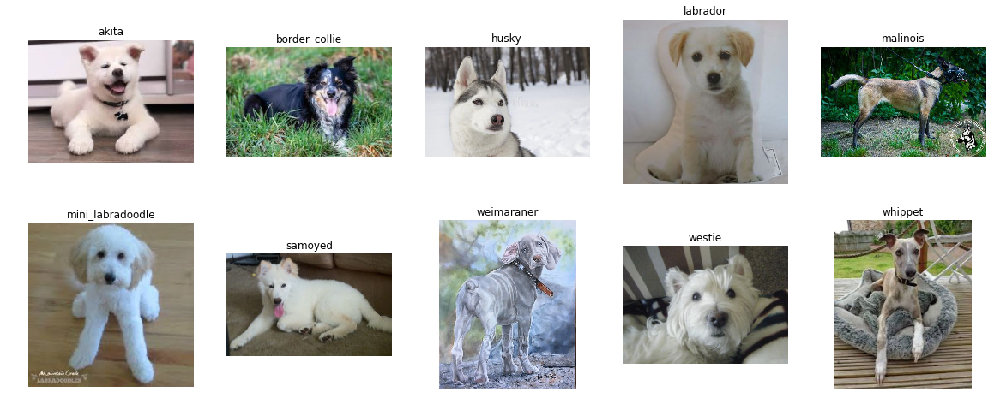

In [0]:
plot_df_images_c(df_full, 'path', 'category', 5)

## Image distribution by height/width ratio

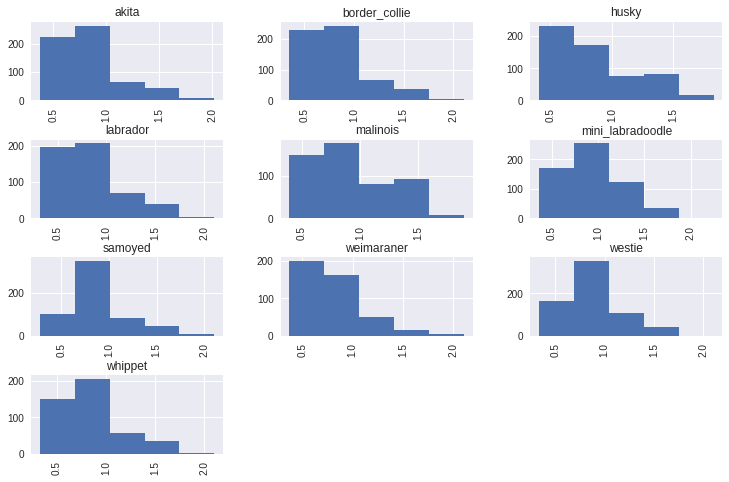

In [0]:
plt.style.use('seaborn')
ax = df_full.hist(by=df_full.category, bins=5, column='h/w ratio', figsize=(12,8))

## Image distribution by label

In [0]:
df_full.groupby('category')['path'].nunique()

category
akita               601
border_collie       584
husky               580
labrador            516
malinois            508
mini_labradoodle    583
samoyed             586
weimaraner          435
westie              667
whippet             447
Name: path, dtype: int64

Text(0.5, 1.0, 'All images distribution by category')

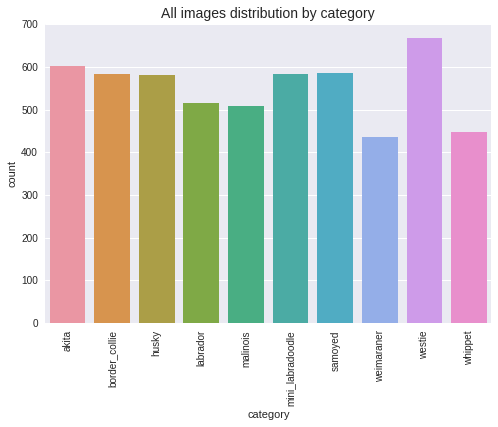

In [0]:
plt.style.use('seaborn')
sns.countplot(df_full['category'].sort_values(), data=df_full)
plt.xticks(rotation=90)
plt.title('All images distribution by category', fontsize=14)

## Image shape distribution

In [0]:
df_full.groupby('shape')['path'].nunique()

shape
(109, 400, 3)      5
(127, 400, 3)      2
(130, 400, 3)      1
(133, 400, 3)      1
(140, 400, 3)      2
(141, 400, 3)      3
(143, 400, 3)      1
(145, 400, 3)      1
(146, 400, 3)      1
(147, 400, 3)      1
(149, 400, 3)      2
(150, 400, 3)      1
(151, 400, 3)      2
(155, 400, 3)      2
(156, 400, 3)      1
(158, 400, 3)      4
(161, 400, 3)      2
(162, 400, 3)      4
(163, 400, 3)      6
(165, 400, 3)      4
(166, 400, 3)      1
(167, 400, 3)      2
(169, 400, 3)      2
(170, 400, 3)      1
(171, 400, 3)      1
(174, 400, 3)      2
(175, 400, 3)      3
(177, 400, 3)      3
(178, 400, 3)      1
(179, 400, 3)      1
                ... 
(400, 370, 3)      8
(400, 371, 3)      8
(400, 372, 3)      1
(400, 373, 3)      3
(400, 374, 3)     10
(400, 375, 3)      4
(400, 376, 3)      3
(400, 377, 3)      5
(400, 378, 3)      3
(400, 379, 3)      6
(400, 381, 3)      5
(400, 382, 3)      1
(400, 383, 3)      9
(400, 384, 3)     15
(400, 385, 3)      4
(400, 386, 3)      3
(400, 3

In [0]:
df_full.groupby(['height', 'width'])[['path']].nunique().sort_values(by='path', ascending=False).head(3)

,,path
height,width,
400,400,626
266,400,459
300,400,436


In [0]:
df_full.groupby(['height', 'width'])[['path']].nunique().sort_values(by='path', ascending=False).tail(3)

path
height width      
400    193       1
       313       1
197    400       1

In [0]:
df_full[['height', 'width']].max()

height    400
width     400
dtype: int64

In [0]:
df_full[['height', 'width']].min()

height    109
width     178
dtype: int64

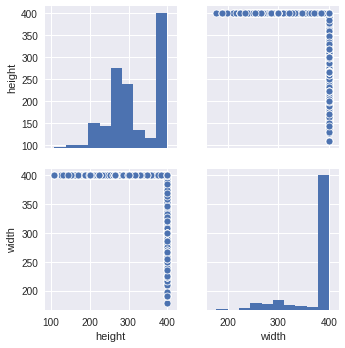

In [0]:
g = sns.pairplot(df_full, vars=['height', 'width'])

# Image data preprocessing

In [0]:
IMG_DIMS = (299, 299, 3)

In [0]:
train_data, valid_data, test_data = ImageDataset.split(
    dataset=ImageDataset.from_subfolders(DATA_DIR / "dogs_train"),
    fracs=(0.8, 0.1, 0.1),
)

In [0]:
train_image_dataset = (
    train_data
    .dataset(batch_size=32, img_dims=IMG_DIMS, shuffle=True)
    .make_pipeline(
        image_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3, flips="both"),
        ],
    )
    .save_pipeline(TEMP_DIR/"train")
    .preprocess()
)

In [0]:
valid_image_dataset = (
    valid_data
    .dataset(batch_size=32, img_dims=IMG_DIMS, shuffle=False)
    .make_pipeline(
        label_map=train_image_dataset.label_map,
        image_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
        ],
    )
    .save_pipeline(TEMP_DIR/"pred")
    .preprocess()
)

In [0]:
test_image_dataset = (
    test_data
    .dataset(batch_size=32, img_dims=IMG_DIMS, shuffle=False)
    .load_pipeline(TEMP_DIR/"pred")
    .preprocess()
)

In [0]:
[len(x) for x in (train_image_dataset, valid_image_dataset, test_image_dataset)]

[4406, 551, 550]

In [0]:
train_image_dataset.label_map

{'akita': 0,
 'border_collie': 1,
 'husky': 2,
 'labrador': 3,
 'malinois': 4,
 'mini_labradoodle': 5,
 'samoyed': 6,
 'weimaraner': 7,
 'westie': 8,
 'whippet': 9}

In [0]:
valid_image_dataset.label_map

{'akita': 0,
 'border_collie': 1,
 'husky': 2,
 'labrador': 3,
 'malinois': 4,
 'mini_labradoodle': 5,
 'samoyed': 6,
 'weimaraner': 7,
 'westie': 8,
 'whippet': 9}

In [0]:
test_image_dataset.label_map

{'akita': 0,
 'border_collie': 1,
 'husky': 2,
 'labrador': 3,
 'malinois': 4,
 'mini_labradoodle': 5,
 'samoyed': 6,
 'weimaraner': 7,
 'westie': 8,
 'whippet': 9}

In [0]:
data_container = DataContainer(
    train=train_image_dataset,
    validation=valid_image_dataset,
    test=test_image_dataset,
)

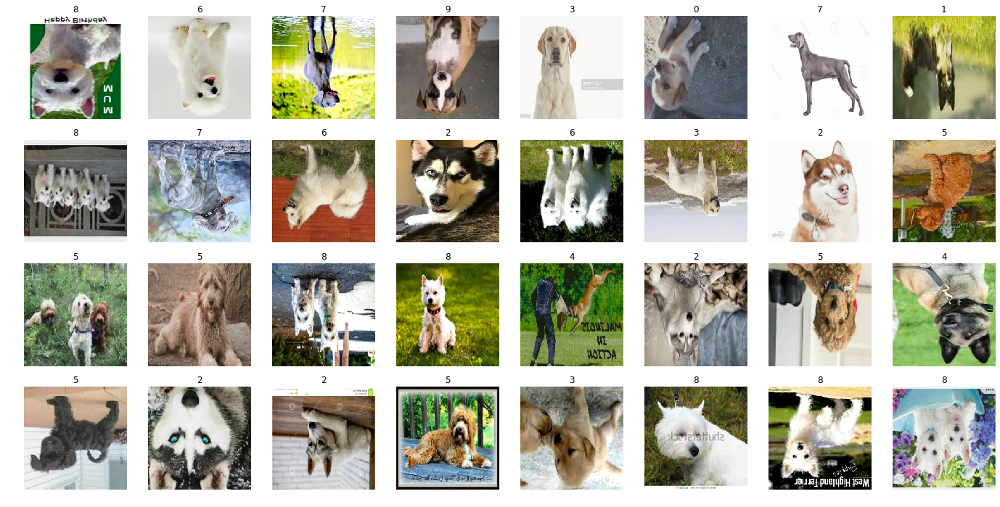

In [0]:
data_container.train.show()

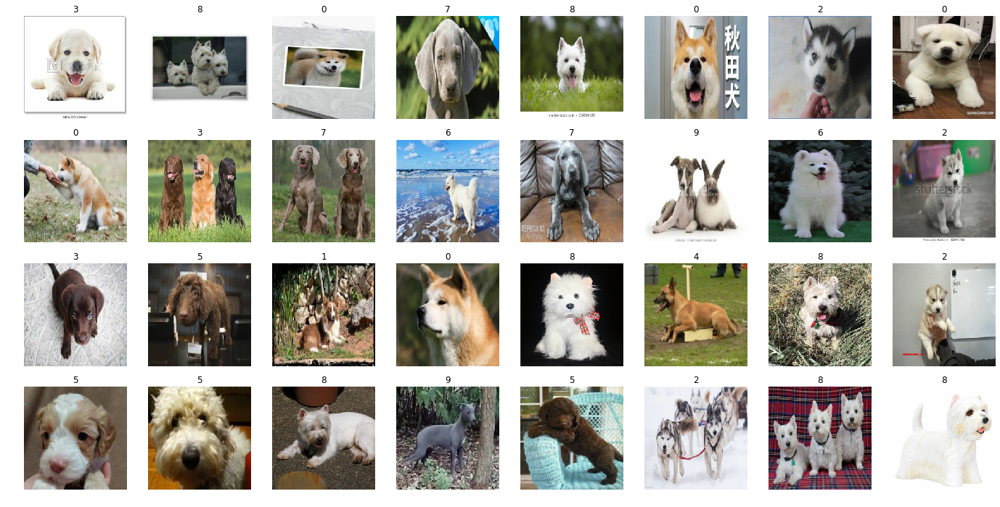

In [0]:
data_container.validation.show()

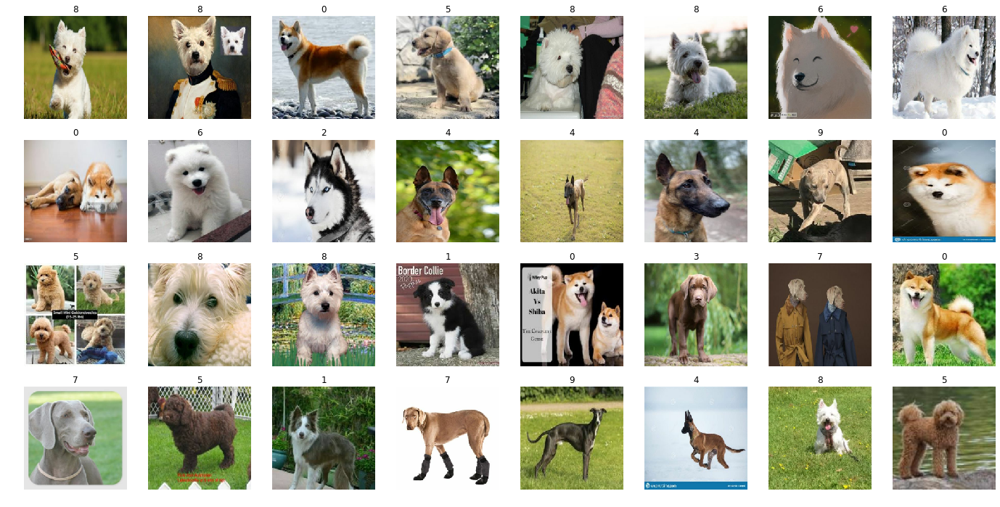

In [0]:
data_container.test.show()

# Inverse image search using embeddings from a pre-trained image model

## Model 1 - Xception
*IIS Using embedings*

In [0]:
learner = ImageLearner(
    path=TEMP_DIR/"xception_v2",
    base_model=keras.applications.Xception,
    input_shape=IMG_DIMS,
    output_shape=[data_container.train.n_classes],
    activation=keras.activations.softmax,
    loss=keras.losses.sparse_categorical_crossentropy,
    metrics=[keras.metrics.sparse_categorical_accuracy, sparse_top_2_categorical_accuracy],
    dropout=0.5,
    l1=3e-6,
    l2=3e-5,
    override=True,
)

In [0]:
trainer_v0 = ImageTrainer(
    learner=learner,
    data_container=data_container,
   
)

In [0]:
cycles = [
    ImageTrainingCycle(
        n_epochs=5,
        lr=3e-4,
        optimizer=keras.optimizers.Adam,
        freeze=True,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3),
        ],
    ),
    ImageTrainingCycle(
        n_epochs=10,
        lr=3e-5,
        optimizer=keras.optimizers.Adam,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=5, flips="both"),
        ],
    ),
    ImageTrainingCycle(
        n_epochs=5,
        lr=1e-5,
        optimizer=keras.optimizers.Adam,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3),
        ],
    ),
]

In [0]:
trainer_v0.train(cycles)

Train for 138 steps, validate for 18 steps
Epoch 1/5
138/138 [==============================] - 109s 790ms/step - loss: 1.2499 - sparse_categorical_accuracy: 0.6119 - sparse_top_2_categorical_accuracy: 0.7430 - val_loss: 0.2521 - val_sparse_categorical_accuracy: 0.9253 - val_sparse_top_2_categorical_accuracy: 0.9774
Epoch 2/5
138/138 [==============================] - 69s 501ms/step - loss: 0.6469 - sparse_categorical_accuracy: 0.8059 - sparse_top_2_categorical_accuracy: 0.8906 - val_loss: 0.2467 - val_sparse_categorical_accuracy: 0.9323 - val_sparse_top_2_categorical_accuracy: 0.9757
Epoch 3/5
138/138 [==============================] - 67s 483ms/step - loss: 0.5342 - sparse_categorical_accuracy: 0.8379 - sparse_top_2_categorical_accuracy: 0.9149 - val_loss: 0.2573 - val_sparse_categorical_accuracy: 0.9323 - val_sparse_top_2_categorical_accuracy: 0.9826
Epoch 4/5
138/138 [==============================] - 67s 483ms/step - loss: 0.4923 - sparse_categorical_accuracy: 0.8542 - sparse_top_

In [0]:
trainer_v0.evaluate_dataset()

18/18 [==============================] - 6s 332ms/step - loss: 0.1544 - sparse_categorical_accuracy: 0.9705 - sparse_top_2_categorical_accuracy: 0.9896


[0.15437731757346126, 0.9704861, 0.9895833]

In [0]:
trainer_v0.evaluate_dataset(mode="test")

18/18 [==============================] - 23s 1s/step - loss: 0.1216 - sparse_categorical_accuracy: 0.9722 - sparse_top_2_categorical_accuracy: 0.9844


[0.12157674811573492, 0.9722222, 0.984375]

In [0]:
xception_v0_analyse_dataset = trainer_v0.analyse_dataset()
xception_v0_analyse_dataset.to_csv(TEMP_DIR/'xception_v2/analyse_dataset_xception_v2.csv', index=False)
xception_v0_analyse_dataset = pd.read_csv(TEMP_DIR/'xception_v2/analyse_dataset_xception_v2.csv')

In [0]:
xception_v0_analyse_test_dataset = trainer_v0.analyse_dataset(mode='test')
xception_v0_analyse_test_dataset.to_csv(TEMP_DIR/'xception_v2/analyse_tets_dataset_xception_v2.csv', index=False)
xception_v0_analyse_test_dataset = pd.read_csv(TEMP_DIR/'xception_v2/analyse_tets_dataset_xception_v2.csv')

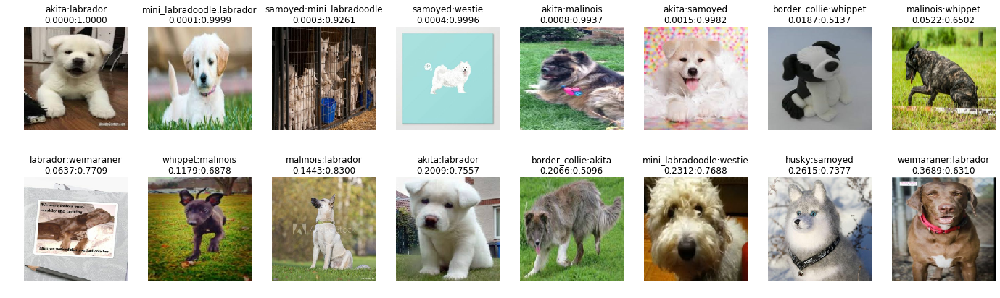

In [0]:
trainer_v0.show_predictions()

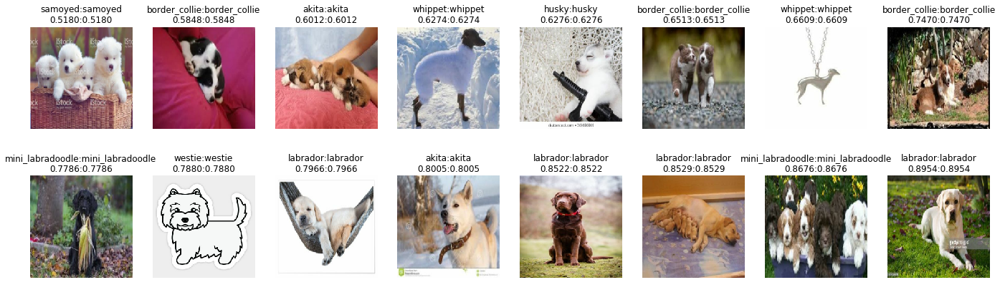

In [0]:
trainer_v0.show_predictions(correct=True)

In [0]:
print(classification_report(xception_v0_analyse_dataset.label_code, xception_v0_analyse_dataset.pred_code))

              precision    recall  f1-score   support

           0       0.98      0.94      0.96        65
           1       1.00      0.96      0.98        51
           2       1.00      0.98      0.99        59
           3       0.93      0.98      0.95        63
           4       0.96      0.96      0.96        51
           5       0.98      0.96      0.97        46
           6       0.96      0.96      0.96        51
           7       0.98      0.98      0.98        49
           8       0.97      1.00      0.99        66
           9       0.96      0.98      0.97        50

    accuracy                           0.97       551
   macro avg       0.97      0.97      0.97       551
weighted avg       0.97      0.97      0.97       551



In [0]:
print(classification_report(xception_v0_analyse_test_dataset.label_code, xception_v0_analyse_test_dataset.pred_code))

              precision    recall  f1-score   support

           0       1.00      0.94      0.97        53
           1       0.96      0.95      0.96        57
           2       0.98      1.00      0.99        53
           3       0.92      0.98      0.95        50
           4       0.98      0.98      0.98        62
           5       0.98      0.90      0.94        51
           6       0.99      0.99      0.99        67
           7       0.95      1.00      0.98        41
           8       0.97      1.00      0.99        75
           9       0.98      0.98      0.98        41

    accuracy                           0.97       550
   macro avg       0.97      0.97      0.97       550
weighted avg       0.97      0.97      0.97       550



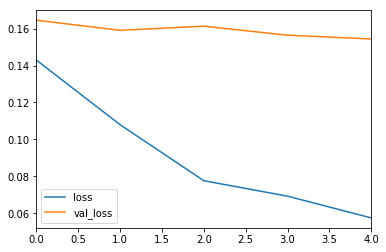

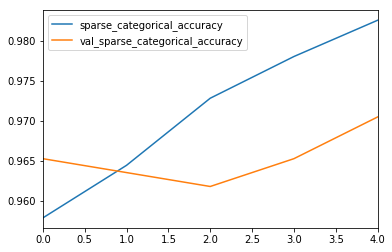

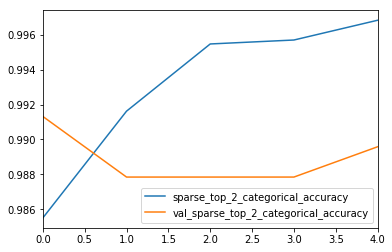

In [0]:
learner.show_history('loss')
learner.show_history('sparse_categorical_accuracy')
learner.show_history('sparse_top_2_categorical_accuracy')

In [0]:
learner.model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 111, 111, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 111, 111, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 111, 111, 32) 0           block1_conv1_bn[0][0]            
______________________________________________________________________________________________

#### IIS Embeddings Model 1 - Xception

In [0]:
learner.model = keras.Model(
    inputs=learner.base_model.input, outputs=learner.concat_layer
)

In [0]:
learner.model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 111, 111, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 111, 111, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 111, 111, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [0]:
image_embeddings = learner.predict(
    pipeline=data_container.train.image_pipeline, image_paths=data_container.train.x
)

In [0]:
nbrs = sk.neighbors.NearestNeighbors(n_neighbors=11, algorithm="ball_tree").fit(
    image_embeddings
)

In [0]:
def show_distances(
    dataset,
    target_index,
    similar_indices,
    distances,
    cols: int = 4,
    debug: bool = False,
):
    if cols >= len(distances) + 1:
        cols = len(distances) + 1
        rows = 1
    else:
        rows = math.ceil((len(distances) + 1) / cols)

    figsize = (3 * cols, 4 * rows) if debug else (3 * cols, 3 * rows)
    _, ax = plt.subplots(rows, cols, figsize=figsize)

    for i, (x, y, distance) in enumerate(
        zip(
            dataset.x[[target_index] + similar_indices],
            dataset.y[[target_index] + similar_indices],
            [0] + distances,
        )
    ):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(Image.open(x))
        title = f"Label: {y}\nShape: {x.shape}\n" if debug else f"{y}\n{distance:.2f}"
        ax[idx].set_title(title)

In [0]:
# Prints metrics and plots images from all categories
def show_all_distances(
    learner,
    dataset,
    cols: int = 4,
    debug: bool = False,
    n=0,

):
    for cat in np.unique(data_container.train.y):
        new_image_index = np.where([data_container.train.y == cat])[1][n]
        new_image_embeddings = learner.predict(
            pipeline=data_container.train.image_pipeline,
            image_paths=data_container.train.x[new_image_index : new_image_index + 1],)
            
        distances, indices = nbrs.kneighbors(new_image_embeddings)
        
        print(f'{cat.upper()}\n{indices[0].tolist()}')
        print(f'{[round(elem, 2) for elem in distances[0].tolist()]}')
        print('Max, Median, Mean, Std:')
        print(f'{[fn(new_image_embeddings) for fn in (np.max, np.median, np.mean, np.std)]}\n')
    
        if cols >= len(distances[0].tolist()) + 1:
            cols = len(distances[0].tolist()) + 1
            rows = 1
        else:
            rows = math.ceil((len(distances[0].tolist()) + 1) / cols)

        figsize = (3 * cols, 4 * rows) if debug else (3 * cols, 3 * rows)
        _, ax = plt.subplots(rows, cols, figsize=figsize)

        for i, (x, y, distance) in enumerate(
            zip(
                dataset.x[[new_image_index] + indices[0].tolist()],
                dataset.y[[new_image_index] + indices[0].tolist()],
                [0] + distances[0].tolist(),
            )
        ):
            idx = (i // cols, i % cols) if rows > 1 else i % cols
            ax[idx].axis("off")
            ax[idx].imshow(Image.open(x))
            title = f"Label: {y}\nShape: {x.shape}\n" if debug else f"{y}\n{distance:.2f}"
            ax[idx].set_title(title)

In [0]:
show_all_distances(learner,
                   data_container.train,
                  )

Output hidden; open in https://colab.research.google.com to view.

In [0]:
# Choosing the same image for comparison with other models
new_image_index = 42

In [0]:
new_image_embeddings = learner.predict(
    pipeline=data_container.train.image_pipeline,
    image_paths=data_container.train.x[new_image_index : new_image_index + 1],
)

In [0]:
distances, indices = nbrs.kneighbors(new_image_embeddings)

In [0]:
[fn(new_image_embeddings) for fn in (np.min, np.max, np.median, np.mean, np.std)]

[0.0, 4.1024127, 0.26008096, 0.47217414, 0.5683725]

In [0]:
distances[0].tolist(), indices[0].tolist()

([9.51197349940676,
  25.452485628483885,
  25.518765948540693,
  25.91496490314627,
  26.14494388714872,
  26.33915910126292,
  26.540089736583667,
  27.023229961646265,
  27.455275972961353,
  27.496732818346324,
  27.64020279318411],
 [42, 3343, 1809, 4282, 1305, 372, 2435, 4372, 2267, 1986, 237])

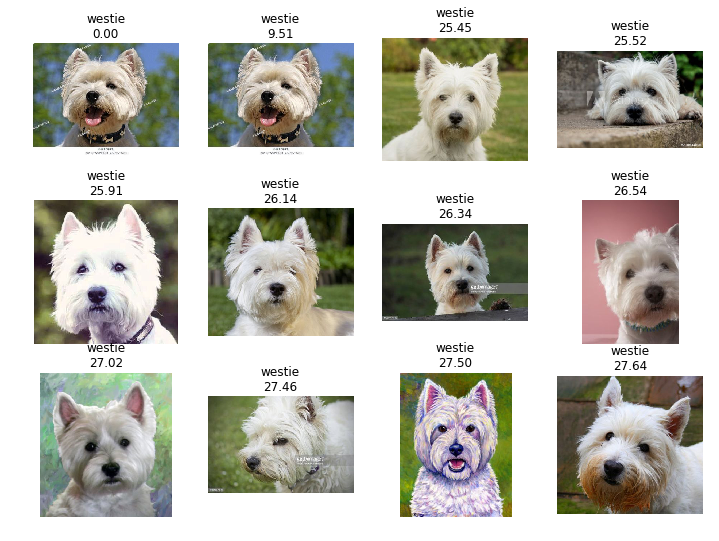

In [0]:
show_distances(
    data_container.train, new_image_index, indices[0].tolist(), distances[0].tolist()
)

## Model 2 - VGG16
*IIS Using embedings*

In [0]:
learner_v2 = ImageLearner(
    path=TEMP_DIR/"VGG16_v2",
    base_model=keras.applications.VGG16,
    input_shape=IMG_DIMS,
    output_shape=[data_container.train.n_classes],
    activation=keras.activations.softmax,
    loss=keras.losses.sparse_categorical_crossentropy,
    metrics=[keras.metrics.sparse_categorical_accuracy, sparse_top_2_categorical_accuracy],
    dropout=0.5,
    l1=3e-6,
    l2=3e-5,
    override=True,
)

In [0]:
trainer_v2 = ImageTrainer(
    learner=learner_v2,
    data_container=data_container,
   
)

In [0]:
cycles = [
    ImageTrainingCycle(
        n_epochs=5,
        lr=3e-4,
        optimizer=keras.optimizers.Adam,
        freeze=True,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3),
        ],
    ),
    ImageTrainingCycle(
        n_epochs=10,
        lr=3e-5,
        optimizer=keras.optimizers.Adam,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=5, flips="both"),
        ],
    ),
    ImageTrainingCycle(
        n_epochs=5,
        lr=1e-5,
        optimizer=keras.optimizers.Adam,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3),
        ],
    ),
]

In [0]:
trainer_v2.train(cycles)

Train for 138 steps, validate for 18 steps
Epoch 1/5
138/138 [==============================] - 76s 550ms/step - loss: 2.7117 - sparse_categorical_accuracy: 0.1565 - sparse_top_2_categorical_accuracy: 0.2806 - val_loss: 1.9376 - val_sparse_categorical_accuracy: 0.3507 - val_sparse_top_2_categorical_accuracy: 0.5312
Epoch 2/5
138/138 [==============================] - 58s 419ms/step - loss: 2.2831 - sparse_categorical_accuracy: 0.2235 - sparse_top_2_categorical_accuracy: 0.3825 - val_loss: 1.6961 - val_sparse_categorical_accuracy: 0.4913 - val_sparse_top_2_categorical_accuracy: 0.6250
Epoch 3/5
138/138 [==============================] - 57s 413ms/step - loss: 2.0082 - sparse_categorical_accuracy: 0.3030 - sparse_top_2_categorical_accuracy: 0.4719 - val_loss: 1.5068 - val_sparse_categorical_accuracy: 0.5486 - val_sparse_top_2_categorical_accuracy: 0.7240
Epoch 4/5
138/138 [==============================] - 56s 406ms/step - loss: 1.8246 - sparse_categorical_accuracy: 0.3567 - sparse_top_2

In [0]:
trainer_v2.evaluate_dataset()

18/18 [==============================] - 5s 282ms/step - loss: 0.1914 - sparse_categorical_accuracy: 0.9375 - sparse_top_2_categorical_accuracy: 0.9809


[0.19137462104360262, 0.9375, 0.9809028]

In [0]:
vgg16_v2_analyse_dataset = trainer_v2.analyse_dataset()
vgg16_v2_analyse_dataset.to_csv(TEMP_DIR/'VGG16_v2/analyse_dataset_vgg16_v2.csv', index=False)
vgg16_v2_analyse_dataset = pd.read_csv(TEMP_DIR/'VGG16_v2/analyse_dataset_vgg16_v2.csv')

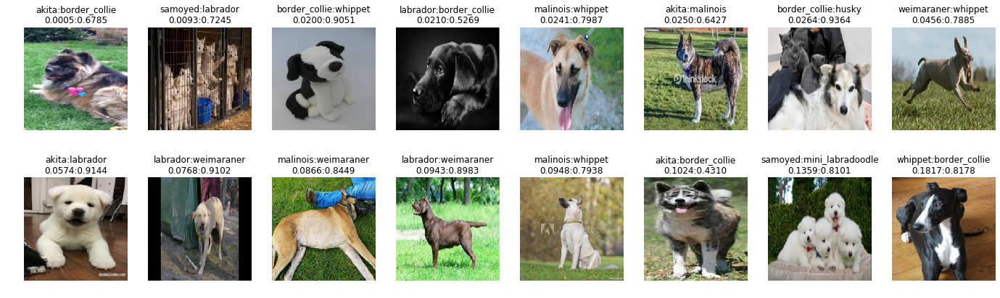

In [0]:
trainer_v2.show_predictions()

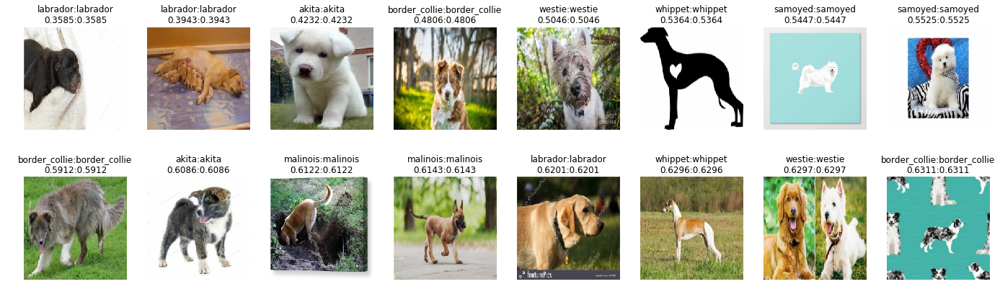

In [0]:
trainer_v2.show_predictions(correct=True)

In [0]:
print(classification_report(vgg16_v2_analyse_dataset.label_code, vgg16_v2_analyse_dataset.pred_code))

              precision    recall  f1-score   support

           0       0.97      0.92      0.94        65
           1       0.91      0.94      0.92        51
           2       0.97      1.00      0.98        59
           3       0.93      0.87      0.90        63
           4       0.94      0.88      0.91        51
           5       0.96      0.96      0.96        46
           6       1.00      0.92      0.96        51
           7       0.87      0.92      0.89        49
           8       0.99      1.00      0.99        66
           9       0.84      0.94      0.89        50

    accuracy                           0.94       551
   macro avg       0.94      0.94      0.93       551
weighted avg       0.94      0.94      0.94       551



#### IIS Embeddings Model 2 - VGG16

In [0]:
learner_v2.model = keras.Model(
    inputs=learner_v2.base_model.input, outputs=learner_v2.concat_layer
)

In [0]:
image_embeddings = learner_v2.predict(
    pipeline=data_container.train.image_pipeline, image_paths=data_container.train.x
)

In [0]:
nbrs = sk.neighbors.NearestNeighbors(n_neighbors=11, algorithm="ball_tree").fit(
    image_embeddings
)

In [0]:
show_all_distances(learner_v2,
                   data_container.train,
                  )

Output hidden; open in https://colab.research.google.com to view.

In [0]:
new_image_index = 42

In [0]:
new_image_embeddings = learner_v2.predict(
    pipeline=data_container.train.image_pipeline,
    image_paths=data_container.train.x[new_image_index : new_image_index + 1],
)

In [0]:
distances, indices = nbrs.kneighbors(new_image_embeddings)

In [0]:
[fn(new_image_embeddings) for fn in (np.min, np.max, np.median, np.mean, np.std)]

[0.0, 9.952194, 0.11536394, 0.376886, 0.6639748]

In [0]:
distances[0].tolist(), indices[0].tolist()

([3.791399765397734,
  6.4367119038703136,
  6.713489891424137,
  6.802628640294176,
  6.884696162957018,
  6.983195487761383,
  7.041304137385611,
  7.111656453292468,
  7.22990479056375,
  7.2410298503684505,
  7.336073294107002],
 [42, 2132, 933, 51, 3169, 1809, 1305, 4031, 939, 190, 379])

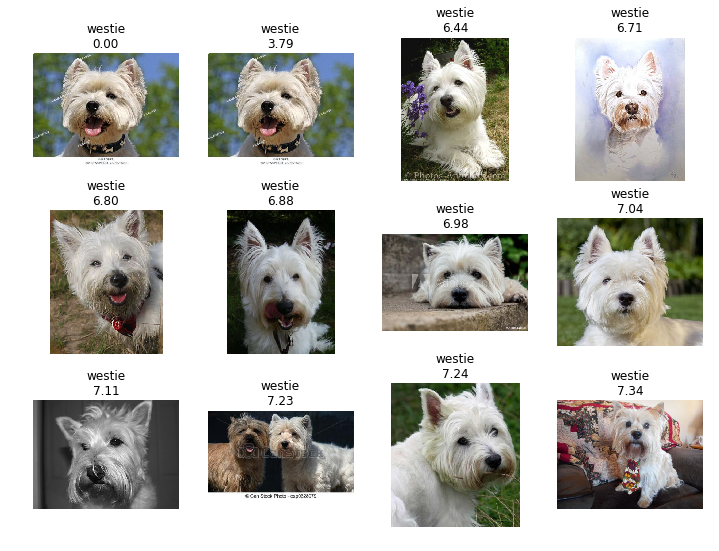

In [0]:
show_distances(
    data_container.train, new_image_index, indices[0].tolist(), distances[0].tolist()
)

## Model 3 - MobileNetV2
*IIS Using embedings*

In [0]:
learner_v3 = ImageLearner(
    path=TEMP_DIR/"MobileNetV2_v2",
    base_model=keras.applications.MobileNetV2,
    input_shape=IMG_DIMS,
    output_shape=[data_container.train.n_classes],
    activation=keras.activations.softmax,
    loss=keras.losses.sparse_categorical_crossentropy,
    metrics=[keras.metrics.sparse_categorical_accuracy, sparse_top_2_categorical_accuracy],
    dropout=0.5,
    l1=3e-6,
    l2=3e-5,
    override=True,
)

In [0]:
trainer_v3 = ImageTrainer(
    learner=learner_v3,
    data_container=data_container,
   
)

In [0]:
cycles = [
    ImageTrainingCycle(
        n_epochs=5,
        lr=3e-4,
        optimizer=keras.optimizers.Adam,
        freeze=True,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3),
        ],
    ),
    ImageTrainingCycle(
        n_epochs=10,
        lr=3e-5,
        optimizer=keras.optimizers.Adam,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=5, flips="both"),
        ],
    ),
    ImageTrainingCycle(
        n_epochs=5,
        lr=1e-5,
        optimizer=keras.optimizers.Adam,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3),
        ],
    ),
]

In [0]:
trainer_v3.train(cycles)

Train for 138 steps, validate for 18 steps
Epoch 1/5
138/138 [==============================] - 46s 335ms/step - loss: 4.3286 - sparse_categorical_accuracy: 0.3295 - sparse_top_2_categorical_accuracy: 0.4930 - val_loss: 0.8400 - val_sparse_categorical_accuracy: 0.7552 - val_sparse_top_2_categorical_accuracy: 0.8872
Epoch 2/5
138/138 [==============================] - 28s 201ms/step - loss: 2.2643 - sparse_categorical_accuracy: 0.5734 - sparse_top_2_categorical_accuracy: 0.7400 - val_loss: 0.5979 - val_sparse_categorical_accuracy: 0.8299 - val_sparse_top_2_categorical_accuracy: 0.9427
Epoch 3/5
138/138 [==============================] - 28s 201ms/step - loss: 1.7196 - sparse_categorical_accuracy: 0.6649 - sparse_top_2_categorical_accuracy: 0.8111 - val_loss: 0.5770 - val_sparse_categorical_accuracy: 0.8507 - val_sparse_top_2_categorical_accuracy: 0.9531
Epoch 4/5
138/138 [==============================] - 27s 197ms/step - loss: 1.5186 - sparse_categorical_accuracy: 0.7063 - sparse_top_2

In [0]:
#new
trainer_v3.evaluate_dataset()

18/18 [==============================] - 2s 93ms/step - loss: 0.1225 - sparse_categorical_accuracy: 0.9601 - sparse_top_2_categorical_accuracy: 0.9878


[0.12253069748274154, 0.9600694, 0.9878472]

In [0]:
trainer_v3.evaluate_dataset(mode="test")

18/18 [==============================] - 2s 92ms/step - loss: 0.1531 - sparse_categorical_accuracy: 0.9566 - sparse_top_2_categorical_accuracy: 0.9844


[0.153091202593512, 0.9565972, 0.984375]

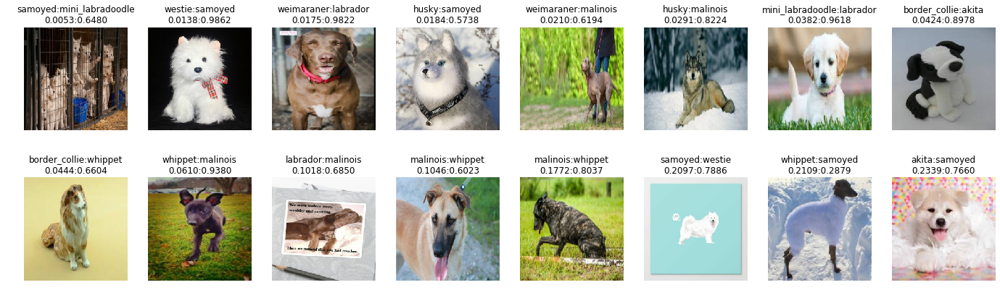

In [0]:
trainer_v3.show_predictions()

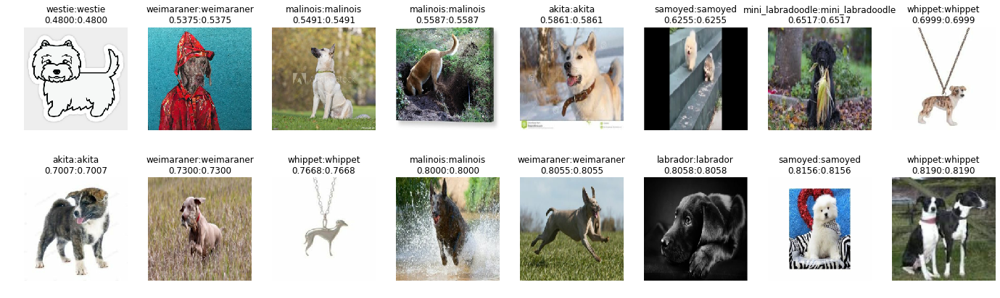

In [0]:
trainer_v3.show_predictions(correct=True)

In [0]:
print(classification_report(mobilenet_v1_analyse_dataset.label_code, mobilenet_v1_analyse_dataset.pred_code))

              precision    recall  f1-score   support

           0       0.97      0.95      0.96        65
           1       0.98      0.96      0.97        51
           2       1.00      0.93      0.96        59
           3       0.97      0.98      0.98        63
           4       0.91      0.96      0.93        51
           5       0.96      0.98      0.97        46
           6       0.91      0.96      0.93        51
           7       1.00      0.96      0.98        49
           8       0.98      0.97      0.98        66
           9       0.92      0.94      0.93        50

    accuracy                           0.96       551
   macro avg       0.96      0.96      0.96       551
weighted avg       0.96      0.96      0.96       551



In [0]:
print(classification_report(mobilenet_v1_analyse_test_dataset.label_code, mobilenet_v1_analyse_test_dataset.pred_code))

              precision    recall  f1-score   support

           0       0.92      0.92      0.92        53
           1       0.96      0.93      0.95        57
           2       0.95      0.98      0.96        53
           3       0.91      0.96      0.93        50
           4       0.98      0.95      0.97        62
           5       1.00      0.98      0.99        51
           6       0.96      0.99      0.97        67
           7       0.97      0.90      0.94        41
           8       0.99      0.97      0.98        75
           9       0.91      0.95      0.93        41

    accuracy                           0.96       550
   macro avg       0.95      0.95      0.95       550
weighted avg       0.96      0.96      0.96       550



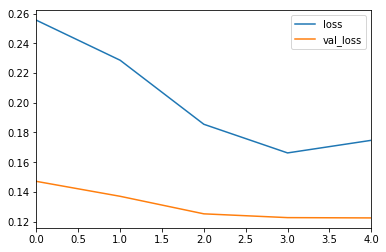

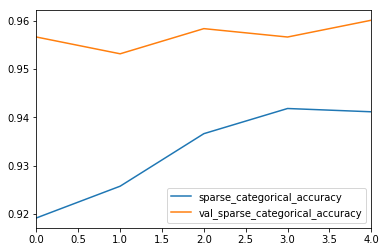

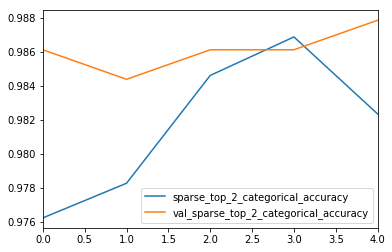

In [0]:
learner_v3.show_history('loss')
learner_v3.show_history('sparse_categorical_accuracy')
learner_v3.show_history('sparse_top_2_categorical_accuracy')

### IIS Embeddings Model 3 - MobileNetV2

In [0]:
learner_v3.model = keras.Model(
    inputs=learner_v3.base_model.input, outputs=learner_v3.concat_layer
)

In [0]:
image_embeddings = learner_v3.predict(
    pipeline=data_container.train.image_pipeline, image_paths=data_container.train.x
)

In [0]:
nbrs = sk.neighbors.NearestNeighbors(n_neighbors=11, algorithm="ball_tree").fit(
    image_embeddings
)

In [0]:
show_all_distances(learner_v3,
                   data_container.train,
                  )

Output hidden; open in https://colab.research.google.com to view.

In [0]:
new_image_index = 42

In [0]:
new_image_embeddings = learner_v3.predict(
    pipeline=data_container.train.image_pipeline,
    image_paths=data_container.train.x[new_image_index : new_image_index + 1],
)

In [0]:
distances, indices = nbrs.kneighbors(new_image_embeddings)

In [0]:
[fn(new_image_embeddings) for fn in (np.min, np.max, np.median, np.mean, np.std)]

[0.0, 6.0, 0.26421627, 1.3817146, 1.9849246]

In [0]:
distances[0].tolist(), indices[0].tolist()

([58.49008536430827,
  81.10665266324278,
  82.4225986235315,
  82.47230308529048,
  83.1649156948869,
  83.80001229090284,
  84.01727523483527,
  84.099870293772,
  84.16750174923715,
  84.28442643551114,
  84.29866555005525],
 [42, 1809, 4372, 1305, 652, 2280, 1044, 4296, 2369, 302, 237])

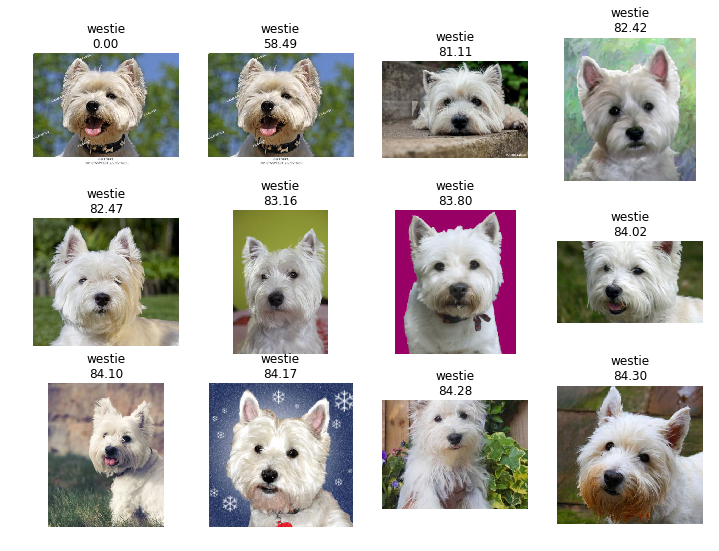

In [0]:
show_distances(
    data_container.train, new_image_index, indices[0].tolist(), distances[0].tolist()
)

## Model 4 - Xception
*IIS using embeddings*

In [0]:
# Increasing IMG_DIMS
IMG_DIMS = (299, 299, 3)

In [0]:
train_image_dataset = (
    train_data
    .dataset(batch_size=32, img_dims=IMG_DIMS, shuffle=True)
    .make_pipeline(
        image_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3, flips="both"),
        ],
    )
    .save_pipeline(TEMP_DIR/"train")
    .preprocess()
)

In [0]:
valid_image_dataset = (
    valid_data
    .dataset(batch_size=32, img_dims=IMG_DIMS, shuffle=False)
    .make_pipeline(
        label_map=train_image_dataset.label_map,
        image_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
        ],
    )
    .save_pipeline(TEMP_DIR/"pred")
    .preprocess()
)

In [0]:
test_image_dataset = (
    test_data
    .dataset(batch_size=32, img_dims=IMG_DIMS, shuffle=False)
    .load_pipeline(TEMP_DIR/"pred")
    .preprocess()
)

In [0]:
data_container = DataContainer(
    train=train_image_dataset,
    validation=valid_image_dataset,
    test=test_image_dataset,
)

In [0]:
learner = ImageLearner(
    path=TEMP_DIR/"xception_v3",
    base_model=keras.applications.Xception,
    input_shape=IMG_DIMS,
    output_shape=[data_container.train.n_classes],
    activation=keras.activations.softmax,
    loss=keras.losses.sparse_categorical_crossentropy,
    metrics=[keras.metrics.sparse_categorical_accuracy, sparse_top_2_categorical_accuracy],
    dropout=0.5,
    l1=3e-6,
    l2=3e-5,
    override=True,
)

In [0]:
trainer_v0 = ImageTrainer(
    learner=learner,
    data_container=data_container,
   
)

In [0]:
cycles = [
    ImageTrainingCycle(
        n_epochs=5,
        lr=3e-4,
        optimizer=keras.optimizers.Adam,
        freeze=True,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3),
        ],
    ),
    ImageTrainingCycle(
        n_epochs=6,
        lr=3e-5,
        optimizer=keras.optimizers.Adam,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=5, flips="both"),
        ],
    ),
    ImageTrainingCycle(
        n_epochs=5,
        lr=1e-5,
        optimizer=keras.optimizers.Adam,
        feature_pipeline=[
            ImageParser(),
            ImageResizer(img_dims=IMG_DIMS, resize="stretch"),
            ImageAugmentor(level=3),
        ],
    ),
]

In [0]:
trainer_v0.train(cycles)

Train for 138 steps, validate for 18 steps
Epoch 1/5
138/138 [==============================] - 139s 1s/step - loss: 0.9816 - sparse_categorical_accuracy: 0.7262 - sparse_top_2_categorical_accuracy: 0.8229 - val_loss: 0.1837 - val_sparse_categorical_accuracy: 0.9497 - val_sparse_top_2_categorical_accuracy: 0.9757
Epoch 2/5
138/138 [==============================] - 111s 802ms/step - loss: 0.4273 - sparse_categorical_accuracy: 0.8832 - sparse_top_2_categorical_accuracy: 0.9402 - val_loss: 0.1314 - val_sparse_categorical_accuracy: 0.9583 - val_sparse_top_2_categorical_accuracy: 0.9792
Epoch 3/5
138/138 [==============================] - 109s 790ms/step - loss: 0.3400 - sparse_categorical_accuracy: 0.9078 - sparse_top_2_categorical_accuracy: 0.9590 - val_loss: 0.1224 - val_sparse_categorical_accuracy: 0.9688 - val_sparse_top_2_categorical_accuracy: 0.9844
Epoch 4/5
138/138 [==============================] - 107s 777ms/step - loss: 0.2945 - sparse_categorical_accuracy: 0.9185 - sparse_top_

In [0]:
trainer_v0.evaluate_dataset()

18/18 [==============================] - 10s 563ms/step - loss: 0.0927 - sparse_categorical_accuracy: 0.9705 - sparse_top_2_categorical_accuracy: 0.9861


[0.0926861158804968, 0.9704861, 0.9861111]

In [0]:
trainer_v0.evaluate_dataset(mode="test")

18/18 [==============================] - 10s 563ms/step - loss: 0.0949 - sparse_categorical_accuracy: 0.9722 - sparse_top_2_categorical_accuracy: 0.9896


[0.09494703989993367, 0.9722222, 0.9895833]

In [0]:
xception_v0_analyse_dataset = trainer_v0.analyse_dataset()
xception_v0_analyse_dataset.to_csv(TEMP_DIR/'xception_v3/analyse_dataset_xception_v2.csv', index=False)
xception_v0_analyse_dataset = pd.read_csv(TEMP_DIR/'xception_v3/analyse_dataset_xception_v2.csv')

In [0]:
xception_v0_analyse_test_dataset = trainer_v0.analyse_dataset(mode='test')
xception_v0_analyse_test_dataset.to_csv(TEMP_DIR/'xception_v3/analyse_tets_dataset_xception_v2.csv', index=False)
xception_v0_analyse_test_dataset = pd.read_csv(TEMP_DIR/'xception_v3/analyse_tets_dataset_xception_v2.csv')

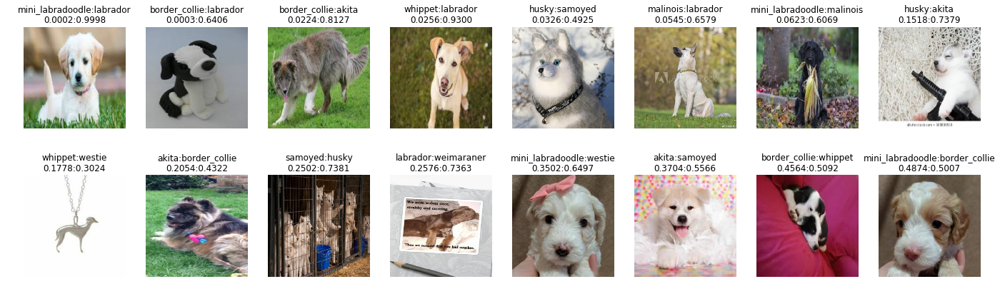

In [0]:
trainer_v0.show_predictions()

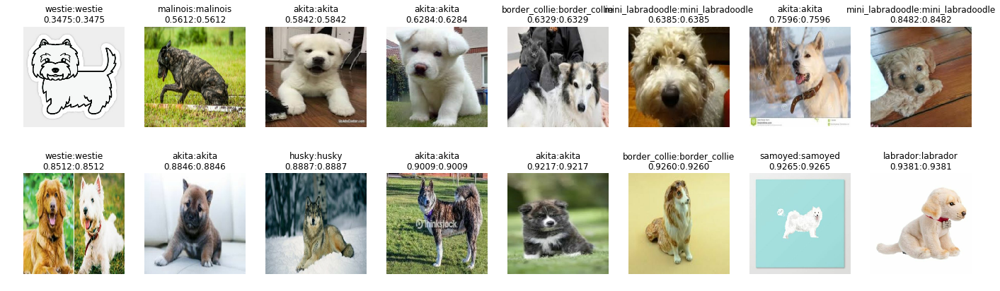

In [0]:
trainer_v0.show_predictions(correct=True)

In [0]:
print(classification_report(xception_v0_analyse_dataset.label_code, xception_v0_analyse_dataset.pred_code))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97        65
           1       0.96      0.94      0.95        51
           2       0.98      0.97      0.97        59
           3       0.94      0.98      0.96        63
           4       0.98      0.98      0.98        51
           5       1.00      0.91      0.95        46
           6       0.96      0.98      0.97        51
           7       0.98      1.00      0.99        49
           8       0.97      1.00      0.99        66
           9       0.98      0.96      0.97        50

    accuracy                           0.97       551
   macro avg       0.97      0.97      0.97       551
weighted avg       0.97      0.97      0.97       551



In [0]:
print(classification_report(xception_v0_analyse_test_dataset.label_code, xception_v0_analyse_test_dataset.pred_code))

              precision    recall  f1-score   support

           0       0.98      0.94      0.96        53
           1       0.98      0.93      0.95        57
           2       0.95      1.00      0.97        53
           3       0.88      0.98      0.92        50
           4       1.00      0.97      0.98        62
           5       0.98      0.98      0.98        51
           6       1.00      0.97      0.98        67
           7       1.00      1.00      1.00        41
           8       1.00      0.99      0.99        75
           9       0.95      0.98      0.96        41

    accuracy                           0.97       550
   macro avg       0.97      0.97      0.97       550
weighted avg       0.97      0.97      0.97       550



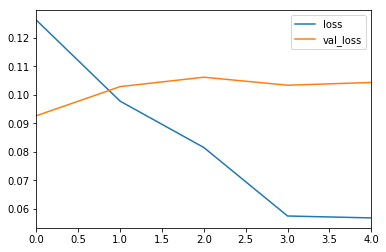

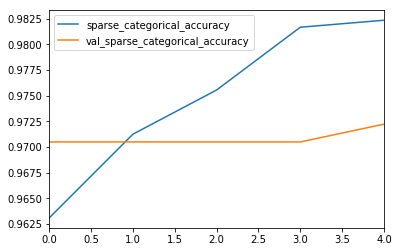

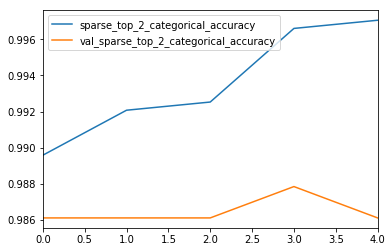

In [0]:
learner.show_history('loss')
learner.show_history('sparse_categorical_accuracy')
learner.show_history('sparse_top_2_categorical_accuracy')

#### IIS Embeddings Model 4 - Xception

In [0]:
learner.model = keras.Model(
    inputs=learner.base_model.input, outputs=learner.concat_layer
)

In [0]:
image_embeddings = learner.predict(
    pipeline=data_container.train.image_pipeline, image_paths=data_container.train.x
)

In [0]:
nbrs = sk.neighbors.NearestNeighbors(n_neighbors=11, algorithm="ball_tree").fit(
    image_embeddings
)

AKITA
[2, 442, 3951, 823, 1712, 2151, 3508, 2180, 2998, 2824, 688]
[12.89, 29.83, 30.6, 31.08, 31.52, 31.73, 32.07, 32.11, 32.46, 32.62, 32.95]
Max, Median, Mean, Std:
[5.267709, 0.2743923, 0.62479407, 0.7765219]

BORDER_COLLIE
[5, 3947, 699, 1030, 3384, 1421, 4263, 587, 502, 3541, 3579]
[15.83, 37.24, 45.19, 45.84, 46.69, 47.15, 47.55, 48.15, 49.5, 49.7, 49.93]
Max, Median, Mean, Std:
[8.396455, 0.028599378, 0.41991132, 0.87194026]

HUSKY
[21, 2601, 3487, 230, 135, 2405, 638, 1187, 2110, 1825, 1156]
[5.11, 20.65, 24.12, 24.2, 24.28, 24.37, 24.64, 24.78, 24.87, 24.91, 25.06]
Max, Median, Mean, Std:
[3.5965192, 0.14024457, 0.41185158, 0.5866399]

LABRADOR
[8, 1360, 1792, 4333, 3117, 4341, 734, 2936, 370, 3076, 1463]
[15.22, 29.28, 33.49, 34.7, 35.07, 35.13, 35.19, 35.72, 36.09, 37.43, 38.27]
Max, Median, Mean, Std:
[6.2375298, 0.12743473, 0.5392183, 0.8916636]

MALINOIS
[14, 2277, 1056, 1887, 2037, 512, 3734, 179, 1308, 1468, 4132]
[17.42, 37.61, 38.97, 39.77, 40.35, 40.69, 40.94, 41.15

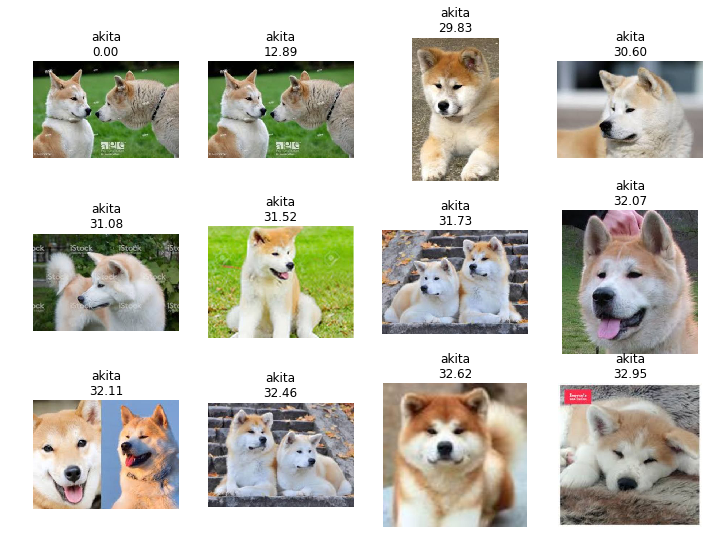

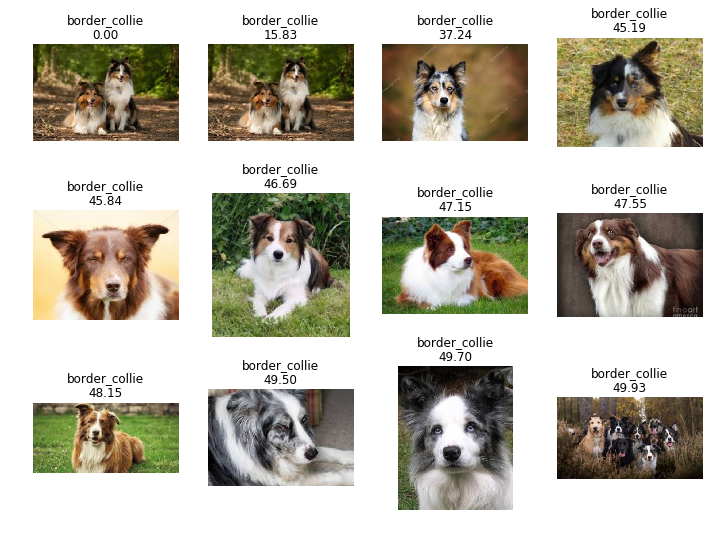

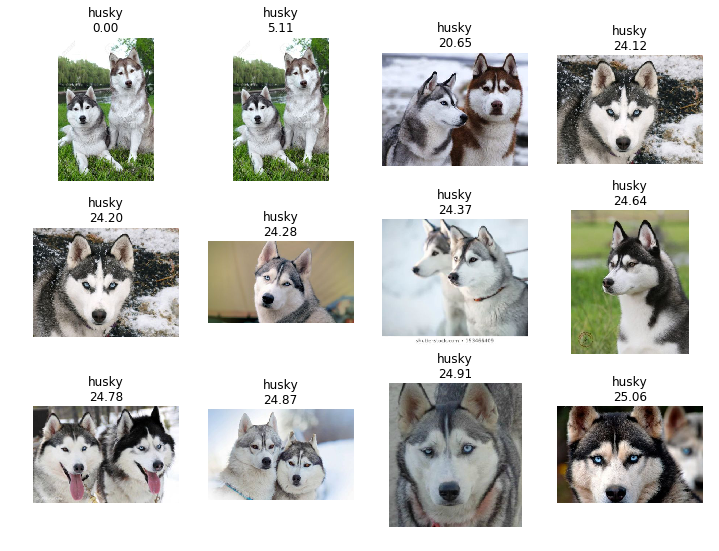

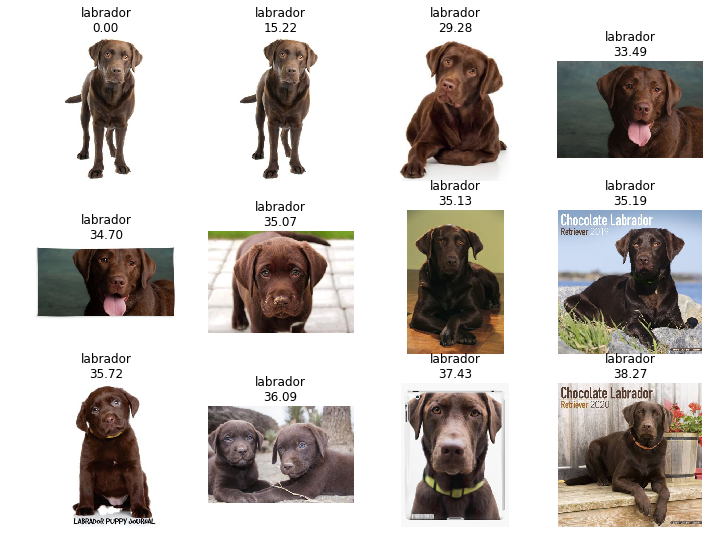

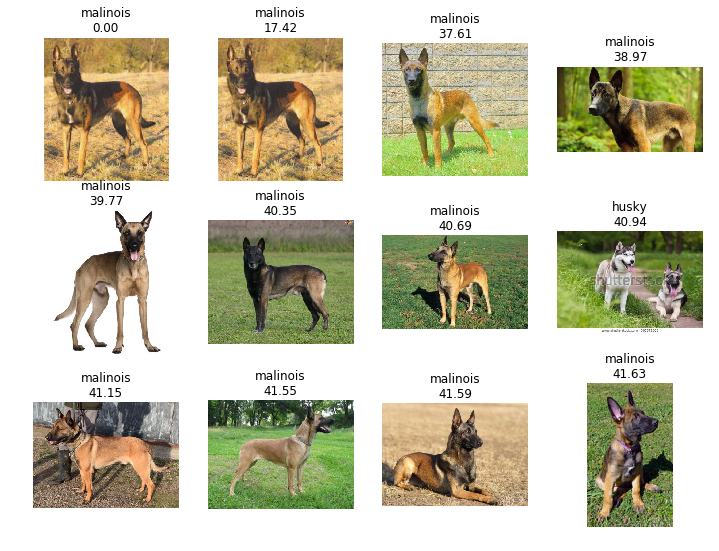

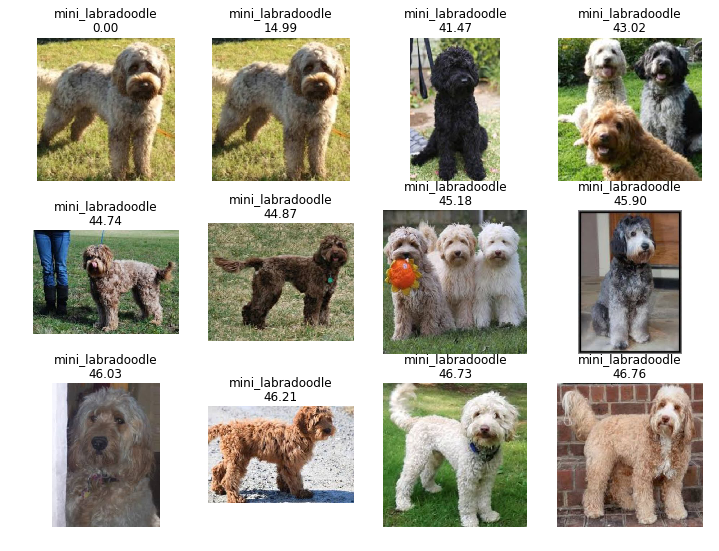

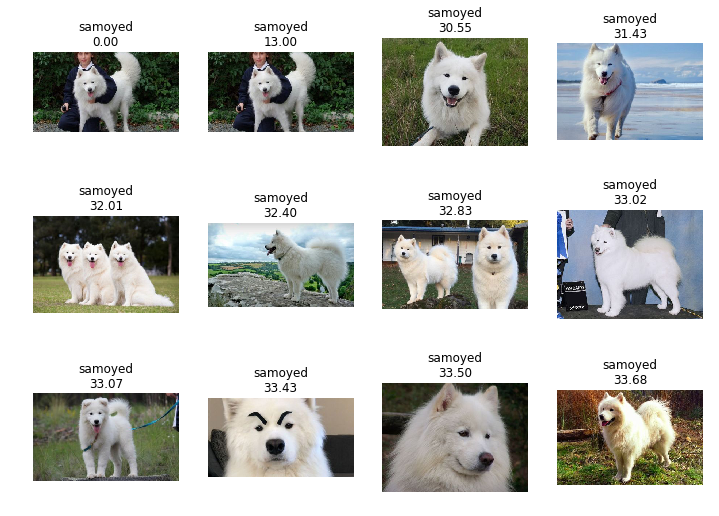

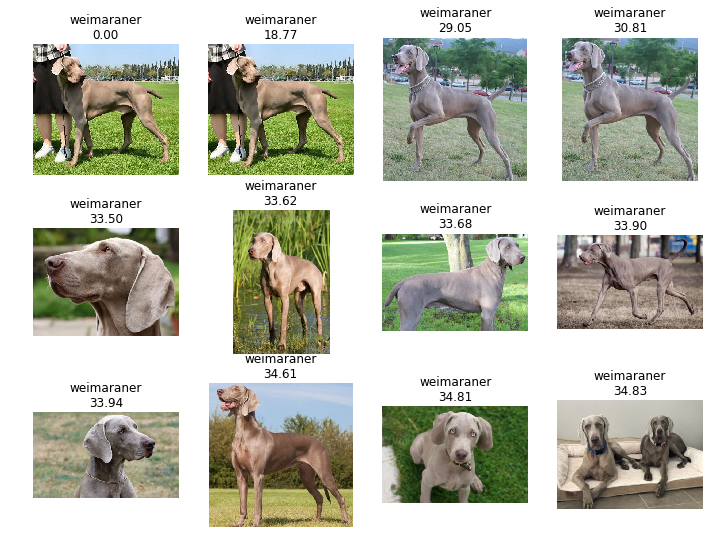

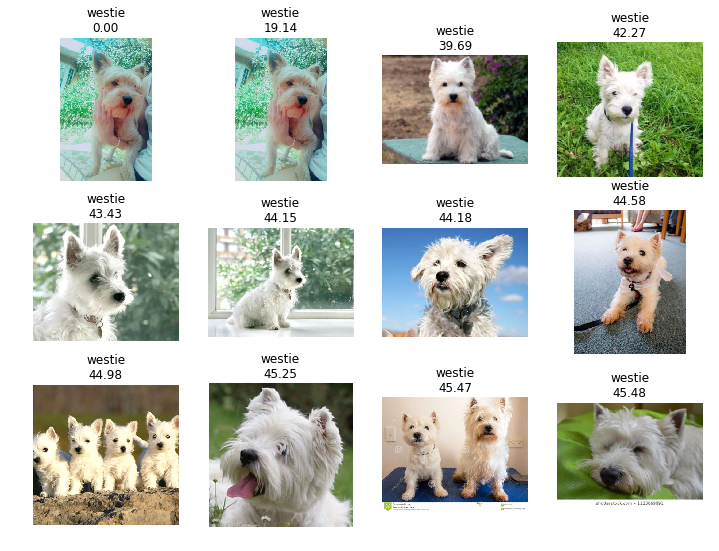

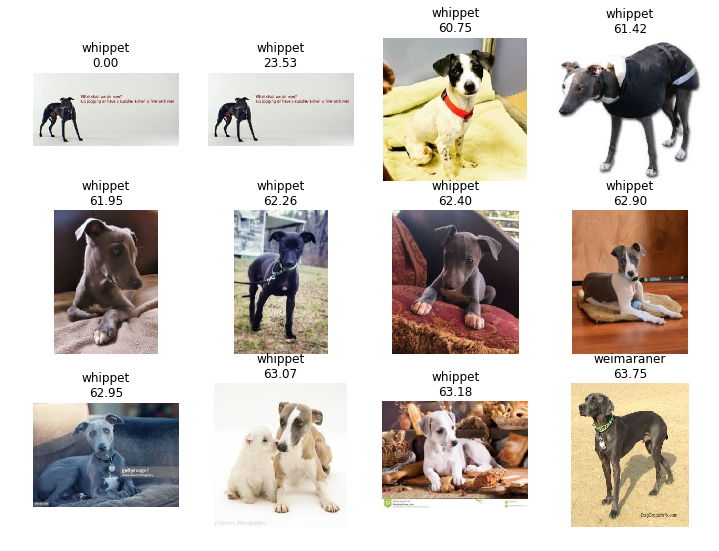

In [0]:
show_all_distances(learner,
                   data_container.train,
                  )

In [0]:
new_image_index = 42

In [0]:
new_image_embeddings = learner.predict(
    pipeline=data_container.train.image_pipeline,
    image_paths=data_container.train.x[new_image_index : new_image_index + 1],
)

In [0]:
distances, indices = nbrs.kneighbors(new_image_embeddings)

In [0]:
[fn(new_image_embeddings) for fn in (np.min, np.max, np.median, np.mean, np.std)]

[0.0, 5.526346, 0.22487238, 0.54550135, 0.76986736]

In [0]:
distances[0].tolist(), indices[0].tolist()

([12.684387306016166,
  29.600896293660497,
  29.971472670480974,
  30.248431924335286,
  30.818355382218407,
  31.144486546081584,
  31.559138954486077,
  31.954625586918528,
  32.002940678052745,
  32.46549326215303,
  32.64012749665933],
 [42, 2280, 2864, 4372, 2015, 97, 4296, 2750, 978, 2753, 2267])

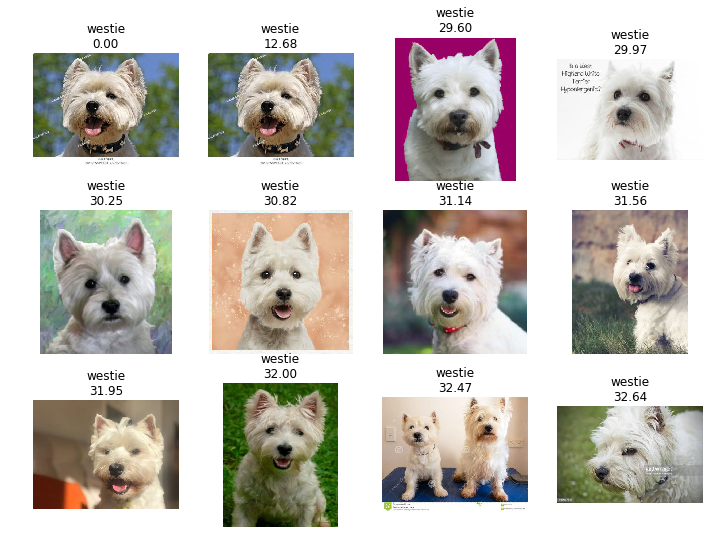

In [0]:
show_distances(
    data_container.train, new_image_index, indices[0].tolist(), distances[0].tolist()
)

# Inverse image search using triplet loss

## Model 5
*IIS using triplet loss*

In [0]:
model = keras.Sequential(
    [
        keras.layers.Conv2D(
            filters=64,
            kernel_size=2,
            padding="same",
            activation="relu",
            input_shape=IMG_DIMS,
        ),
        keras.layers.MaxPooling2D(pool_size=2),
        keras.layers.Dropout(0.3),
        keras.layers.Conv2D(
            filters=32, kernel_size=2, padding="same", activation="relu"
        ),
        keras.layers.MaxPooling2D(pool_size=2),
        keras.layers.Dropout(0.3),
        keras.layers.Flatten(),
        keras.layers.Dense(256, activation=None),
        keras.layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1)),
    ]
)

In [0]:
model.compile(
    optimizer=keras.optimizers.Adam(1e-3), loss=tfa.losses.TripletSemiHardLoss()
)

In [0]:
history = model.fit(
    data_container.train.data, steps_per_epoch=data_container.train.steps, epochs=20
)

Train for 138 steps
Epoch 1/20
138/138 [==============================] - 47s 341ms/step - loss: 0.9242
Epoch 2/20
138/138 [==============================] - 32s 229ms/step - loss: 0.8909
Epoch 3/20
138/138 [==============================] - 31s 226ms/step - loss: 0.9998
Epoch 4/20
138/138 [==============================] - 31s 226ms/step - loss: 0.9998
Epoch 5/20
138/138 [==============================] - 30s 218ms/step - loss: 0.9992
Epoch 6/20
138/138 [==============================] - 28s 205ms/step - loss: 0.9276
Epoch 7/20
138/138 [==============================] - 25s 181ms/step - loss: 0.8948
Epoch 8/20
138/138 [==============================] - 22s 160ms/step - loss: 0.8956
Epoch 9/20
138/138 [==============================] - 22s 159ms/step - loss: 0.8803
Epoch 10/20
138/138 [==============================] - 22s 161ms/step - loss: 0.8804
Epoch 11/20
138/138 [==============================] - 22s 161ms/step - loss: 0.8775
Epoch 12/20
138/138 [==============================] -

In [0]:
def apply_pipeline(pipeline: List[Callable], image_paths: Iterable[str]):
    images = tf.data.Dataset.from_tensor_slices(image_paths)
    for fun in pipeline:
        images = images.map(fun, num_parallel_calls=1)
    images = images.batch(1)
    return images

In [0]:
def show_all_distances_tl(
    model,
    dataset,
    cols: int = 4,
    debug: bool = False,
    n=0,

):
    for cat in np.unique(data_container.train.y):
        new_image_index = np.where([data_container.train.y == cat])[1][n]

        new_prepared_image = apply_pipeline(
            data_container.train.image_pipeline,
            data_container.train.x[new_image_index : new_image_index + 1],
        )

        new_image_embeddings = model.predict(new_prepared_image, steps=1)

        distances, indices = nbrs.kneighbors(new_image_embeddings)
        
        print(f'{cat.upper()}\n{indices[0].tolist()}')
        print(f'{[round(elem, 2) for elem in distances[0].tolist()]}')
        print('Max, Median, Mean, Std:')
        print(f'{[fn(new_image_embeddings) for fn in (np.max, np.median, np.mean, np.std)]}\n')
    
    
        if cols >= len(distances[0].tolist()) + 1:
            cols = len(distances[0].tolist()) + 1
            rows = 1
        else:
            rows = math.ceil((len(distances[0].tolist()) + 1) / cols)

        figsize = (3 * cols, 4 * rows) if debug else (3 * cols, 3 * rows)
        _, ax = plt.subplots(rows, cols, figsize=figsize)

        for i, (x, y, distance) in enumerate(
            zip(
                dataset.x[[new_image_index] + indices[0].tolist()],
                dataset.y[[new_image_index] + indices[0].tolist()],
                [0] + distances[0].tolist(),
            )
        ):
            idx = (i // cols, i % cols) if rows > 1 else i % cols
            ax[idx].axis("off")
            ax[idx].imshow(Image.open(x))
            title = f"Label: {y}\nShape: {x.shape}\n" if debug else f"{y}\n{distance:.2f}"
            ax[idx].set_title(title)

In [0]:
prepared_images = apply_pipeline(
    data_container.train.image_pipeline, data_container.train.x
)

In [0]:
image_embeddings = model.predict(prepared_images)

In [0]:
nbrs = sk.neighbors.NearestNeighbors(n_neighbors=11, algorithm="ball_tree").fit(
    image_embeddings
)

AKITA
[109, 2839, 1853, 369, 739, 3963, 2583, 884, 202, 2782, 2158]
[0.3, 0.33, 0.35, 0.35, 0.36, 0.36, 0.36, 0.37, 0.37, 0.37, 0.37]
Max, Median, Mean, Std:
[0.17688994, 0.0044055535, 0.0024276038, 0.062452838]

BORDER_COLLIE
[5, 3337, 485, 1084, 3468, 3196, 698, 750, 472, 2818, 1184]
[0.12, 0.13, 0.16, 0.17, 0.18, 0.19, 0.19, 0.19, 0.2, 0.2, 0.21]
Max, Median, Mean, Std:
[0.13231467, 0.0052049058, 0.0028018148, 0.06243717]

HUSKY
[21, 2957, 2212, 3992, 2230, 3108, 290, 981, 2006, 2102, 2374]
[0.2, 0.32, 0.32, 0.35, 0.37, 0.38, 0.38, 0.38, 0.39, 0.4, 0.4]
Max, Median, Mean, Std:
[0.16526319, 0.00958279, 0.004798217, 0.062315546]

LABRADOR
[1190, 8, 664, 2186, 3863, 1229, 3188, 440, 1853, 369, 385]
[0.1, 0.11, 0.13, 0.14, 0.14, 0.14, 0.15, 0.15, 0.15, 0.15, 0.16]
Max, Median, Mean, Std:
[0.13363762, 0.0029668596, 0.0030547676, 0.062425304]

MALINOIS
[843, 2083, 565, 167, 3798, 54, 228, 2159, 3988, 4177, 4066]
[0.1, 0.1, 0.11, 0.11, 0.11, 0.12, 0.12, 0.12, 0.12, 0.13, 0.13]
Max, Median,

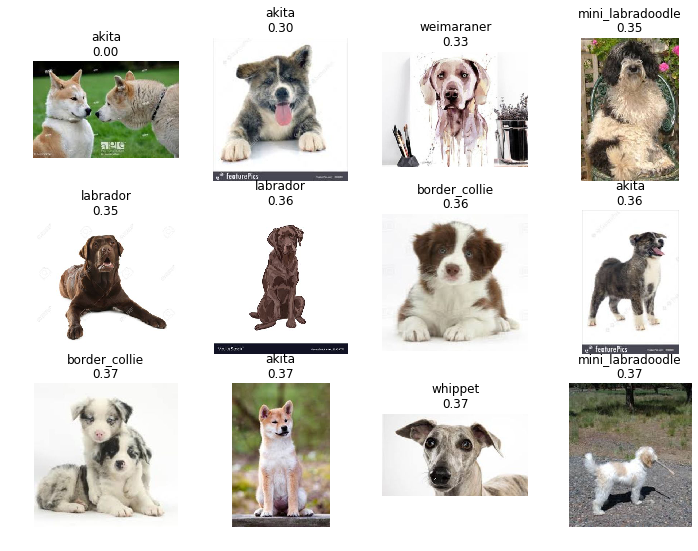

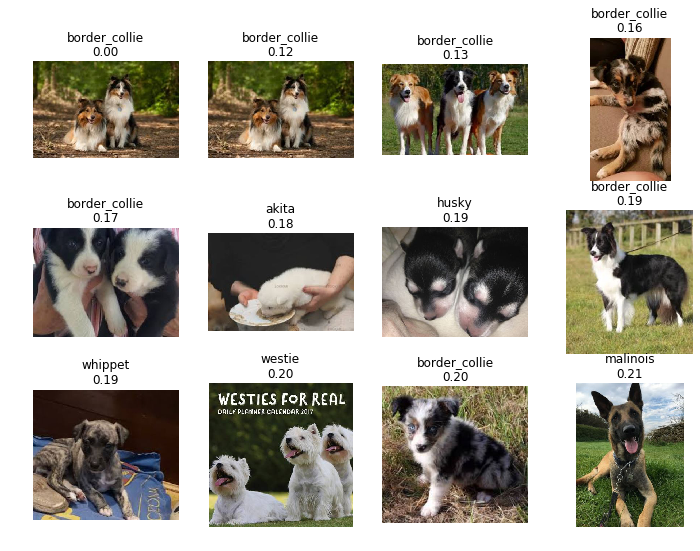

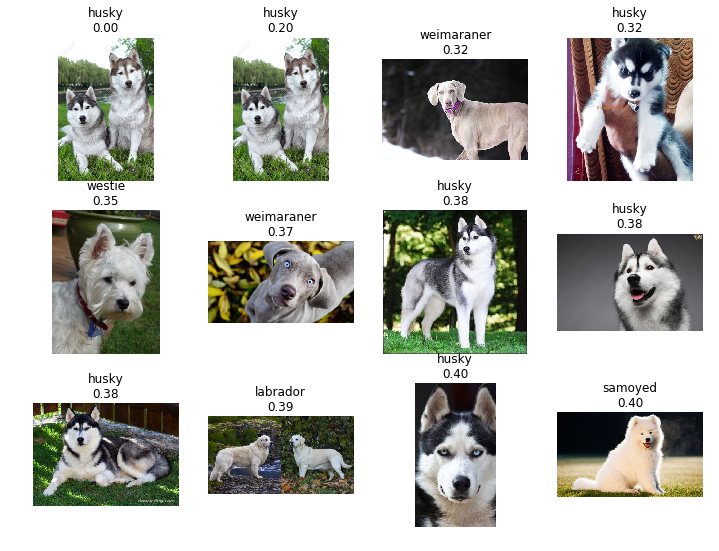

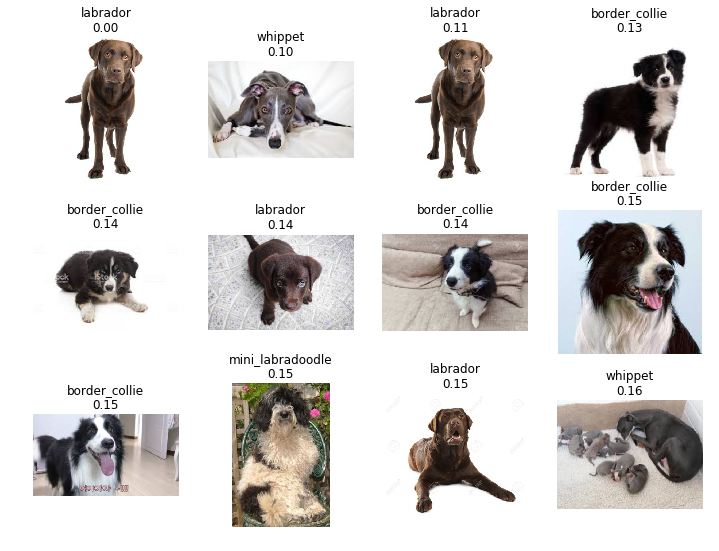

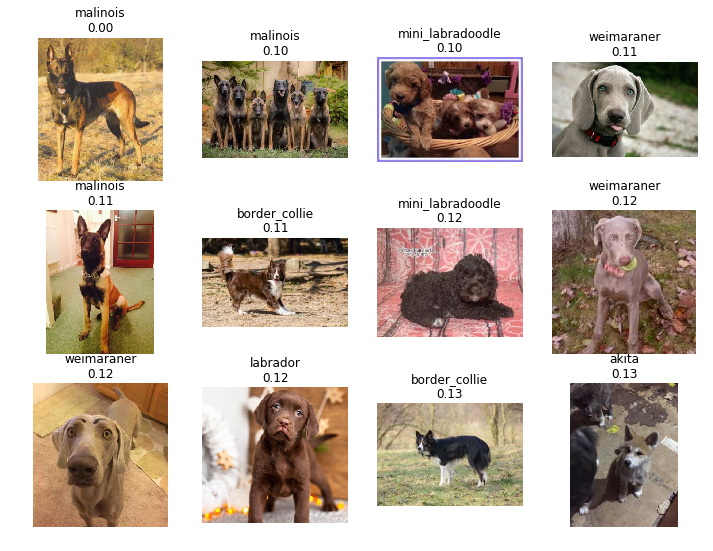

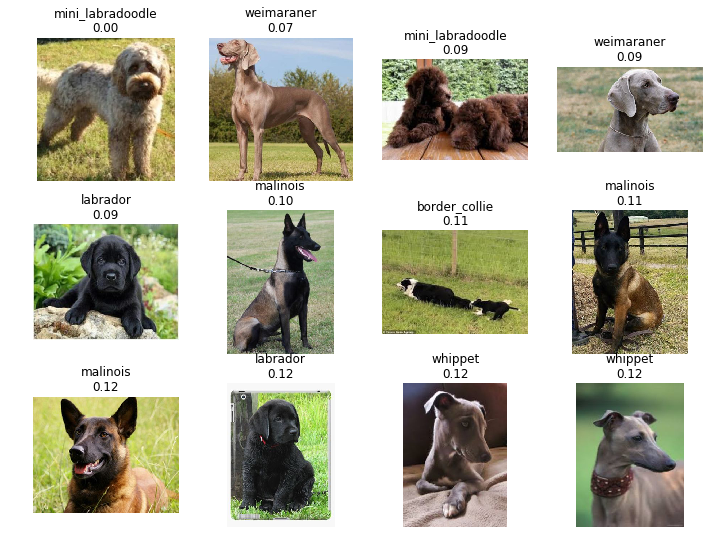

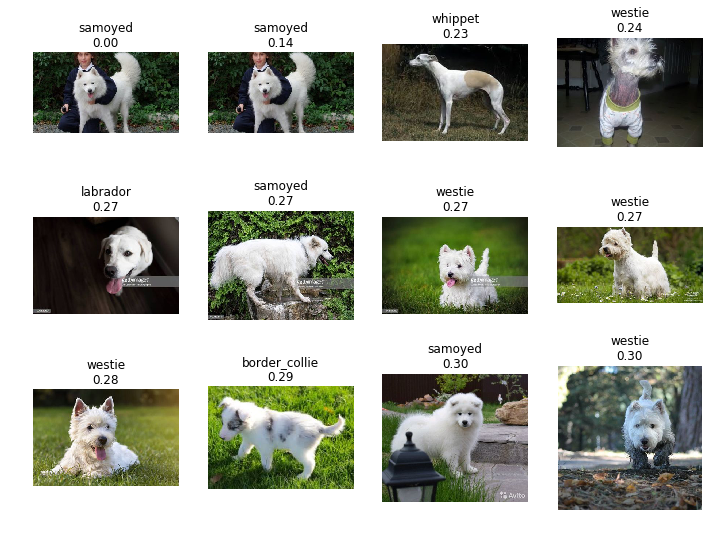

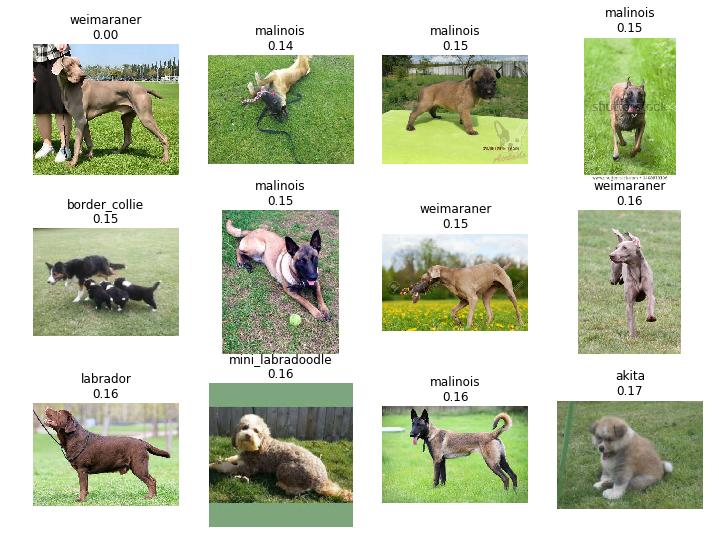

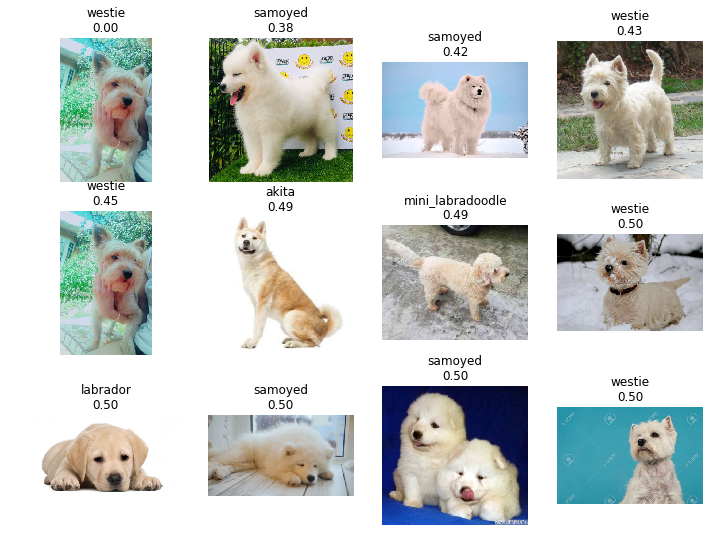

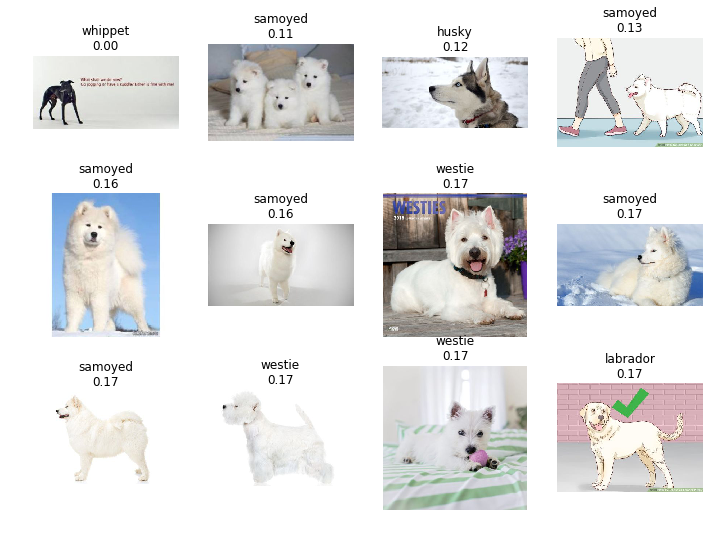

In [0]:
show_all_distances_tl(model,data_container.train)

In [0]:
new_image_index = 42
new_prepared_image = apply_pipeline(
    data_container.train.image_pipeline,
    data_container.train.x[new_image_index : new_image_index + 1],
)
new_image_embeddings = model.predict(new_prepared_image, steps=1)
distances, indices = nbrs.kneighbors(new_image_embeddings)

In [0]:
distances[0].tolist(), indices[0].tolist()

([0.38231815448184736,
  0.4018894235437241,
  0.42152118592466004,
  0.49047045611662377,
  0.5024457533979831,
  0.5188638245966818,
  0.5261262449187976,
  0.5460544798146024,
  0.5522816465056408,
  0.5915185933001218,
  0.5994289008773123],
 [802, 46, 4014, 3981, 1458, 3385, 430, 3170, 1128, 2200, 1075])

In [0]:
[fn(new_image_embeddings) for fn in (np.max, np.median, np.mean, np.std)]

[0.16082564, 0.0010823268, -0.0001754578, 0.062499758]

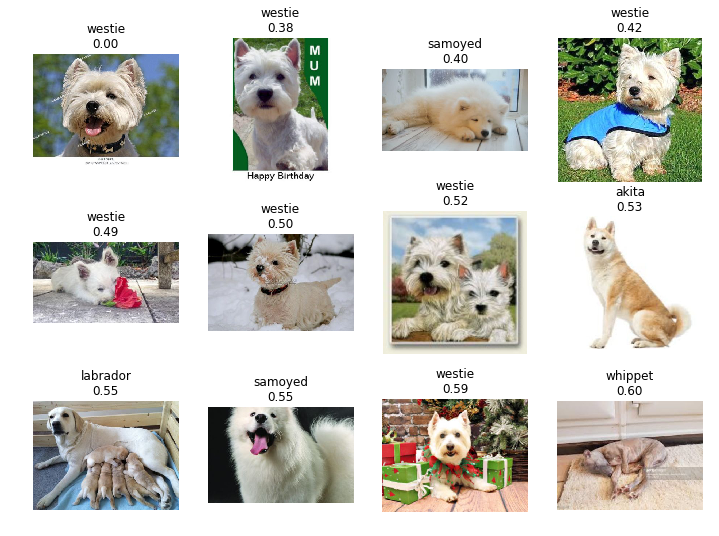

In [0]:
show_distances(
    data_container.train, new_image_index, indices[0].tolist(), distances[0].tolist()
)

## Model 6 - Xception
*IIS using triplet loss*

In [0]:
def make_model(
    n_classes,
    input_shape,
    dropout_rate=0.0,
    l1=1e-8,
    l2=1e-8,
):
    base_model = keras.applications.Xception(include_top=False, input_shape=input_shape)
    x = keras.layers.concatenate([
        keras.layers.GlobalAvgPool2D()(base_model.output),
        keras.layers.GlobalMaxPool2D()(base_model.output),
    ])
    x = keras.layers.BatchNormalization()(x)
    x = keras.layers.Dropout(dropout_rate)(x)
    x = keras.layers.Dense(
        n_classes,
        kernel_regularizer=keras.regularizers.l1_l2(l1, l2),
        activation=keras.activations.softmax,
    )(x)
    x = keras.layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1))(x)
    return keras.Model(inputs=base_model.inputs, outputs=x)

In [0]:
model_2 = make_model(
    n_classes=10,
    input_shape=IMG_DIMS,
    dropout_rate=0.3,
    l1=3e-6,
    l2=3e-5,
)

In [0]:
model_2.compile(
    optimizer=keras.optimizers.Adam(1e-4), loss=tfa.losses.TripletSemiHardLoss()
)

In [0]:
history = model_2.fit(
    x=data_container.train.data,
    validation_data=data_container.validation.data,
    steps_per_epoch=data_container.train.steps,
    validation_steps=data_container.validation.steps,
    epochs=5,
)

Train for 138 steps, validate for 18 steps
Epoch 1/5
138/138 [==============================] - 682s 5s/step - loss: 0.6268 - val_loss: 0.2971
Epoch 2/5
138/138 [==============================] - 340s 2s/step - loss: 0.3677 - val_loss: 0.2220
Epoch 3/5
138/138 [==============================] - 347s 3s/step - loss: 0.3228 - val_loss: 0.1755
Epoch 4/5
138/138 [==============================] - 332s 2s/step - loss: 0.2929 - val_loss: 0.1324
Epoch 5/5
138/138 [==============================] - 329s 2s/step - loss: 0.2713 - val_loss: 0.2143


In [0]:
prepared_images = apply_pipeline(
    data_container.train.image_pipeline, data_container.train.x
)

In [0]:
image_embeddings = model_2.predict(prepared_images)

In [0]:
nbrs = sk.neighbors.NearestNeighbors(n_neighbors=11, algorithm="ball_tree").fit(
    image_embeddings
)

In [0]:
show_all_distances_tl(model_2,data_container.train)

Output hidden; open in https://colab.research.google.com to view.

In [0]:
new_image_index = 100
new_prepared_image = apply_pipeline(
    data_container.train.image_pipeline,
    data_container.train.x[new_image_index : new_image_index + 1],
)
new_image_embeddings = model_2.predict(new_prepared_image, steps=1)
distances, indices = nbrs.kneighbors(new_image_embeddings)

In [0]:
distances[0].tolist(), indices[0].tolist()

([5.82550464141831e-07,
  6.765157465737152e-07,
  7.058293922380022e-07,
  7.963286855578934e-07,
  9.239892170809502e-07,
  9.406674033375946e-07,
  9.433795703409187e-07,
  1.0343978448988193e-06,
  1.1145676613635923e-06,
  1.157123686417967e-06,
  1.258396957416073e-06],
 [3319, 1040, 2012, 182, 1533, 100, 477, 592, 2237, 1262, 4318])

In [0]:
[fn(new_image_embeddings) for fn in (np.max, np.median, np.mean, np.std)]

[1.0, 1.435416e-07, 0.10000028, 0.29999992]

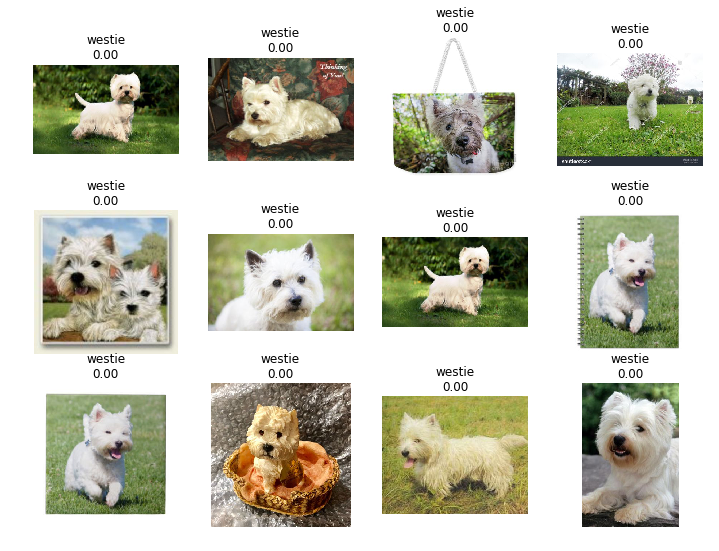

In [0]:
show_distances(
    data_container.train, new_image_index, indices[0].tolist(), distances[0].tolist()
)

## Model 7 - Xception
*IIS using triplet loss*

In [0]:
learner = ImageLearner(
    path=TEMP_DIR/"xception_v9",
    base_model=keras.applications.Xception,
    input_shape=IMG_DIMS,
    output_shape=[data_container.train.n_classes],
    activation=keras.activations.softmax,
    loss=keras.losses.sparse_categorical_crossentropy,
    metrics=[],
    override=True,
)

In [0]:
learner.model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [0]:
learner.squeeze_layer = keras.layers.Dense(
    10,
    activation=keras.activations.relu,
    kernel_initializer=keras.initializers.he_uniform(),
)
learner.output_layer = keras.layers.Dense(
   data_container.train.n_classes, activation=keras.activations.softmax
)

In [0]:
learner.model = keras.Model(
    inputs=learner.base_model.input,
    outputs=learner.output_layer(learner.squeeze_layer(learner.dropout_layer)),
)

In [0]:
learner.model.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [0]:
learner.compile(optimizer=tf.keras.optimizers.Adam, lr=1e-4)

In [0]:
history = learner.model.fit(
    x=data_container.train.data,
    validation_data=data_container.validation.data,
    steps_per_epoch=data_container.train.steps,
    validation_steps=data_container.validation.steps,
    epochs=5
)

Train for 138 steps, validate for 18 steps
Epoch 1/5
138/138 [==============================] - 749s 5s/step - loss: 0.9829 - val_loss: 0.4235
Epoch 2/5
138/138 [==============================] - 350s 3s/step - loss: 0.3847 - val_loss: 0.1759
Epoch 3/5
138/138 [==============================] - 346s 3s/step - loss: 0.2072 - val_loss: 0.1396
Epoch 4/5
138/138 [==============================] - 337s 2s/step - loss: 0.1457 - val_loss: 0.1046
Epoch 5/5
138/138 [==============================] - 335s 2s/step - loss: 0.1052 - val_loss: 0.1178


In [0]:
learner.model = keras.Model(
    inputs=learner.base_model.input,
    outputs=learner.squeeze_layer(learner.dropout_layer),
)

In [0]:
learner.model.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [0]:
learner.compile(optimizer=tf.keras.optimizers.Adam, lr=1e-4)

In [0]:
image_embeddings = learner.predict(
    pipeline=data_container.train.image_pipeline, image_paths=data_container.train.x
)

In [0]:
nbrs = sk.neighbors.NearestNeighbors(n_neighbors=11, algorithm="ball_tree").fit(
    image_embeddings
)

In [0]:
new_image_index = np.random.randint(len(data_container.train))
new_image_index

2789

In [0]:
new_image_embeddings = learner.predict(
    pipeline=data_container.train.image_pipeline,
    image_paths=data_container.train.x[new_image_index : new_image_index + 1],
)

In [0]:
distances, indices = nbrs.kneighbors(new_image_embeddings)

In [0]:
[fn(new_image_embeddings) for fn in (np.min, np.max, np.median, np.mean, np.std)]

[0.0, 17.11194, 0.0, 2.4354637, 5.347526]

In [0]:
distances[0].tolist(), indices[0].tolist()

([0.1809598499970964,
  0.271095290996038,
  0.34835275490575524,
  0.3726148001252447,
  0.3963140615026507,
  0.5225331767201975,
  0.5326655279252419,
  0.6182333621625018,
  0.7105238892430665,
  0.7315883861017451,
  0.7436230613350536],
 [3061, 790, 4227, 422, 4392, 860, 1249, 1218, 1397, 753, 2397])

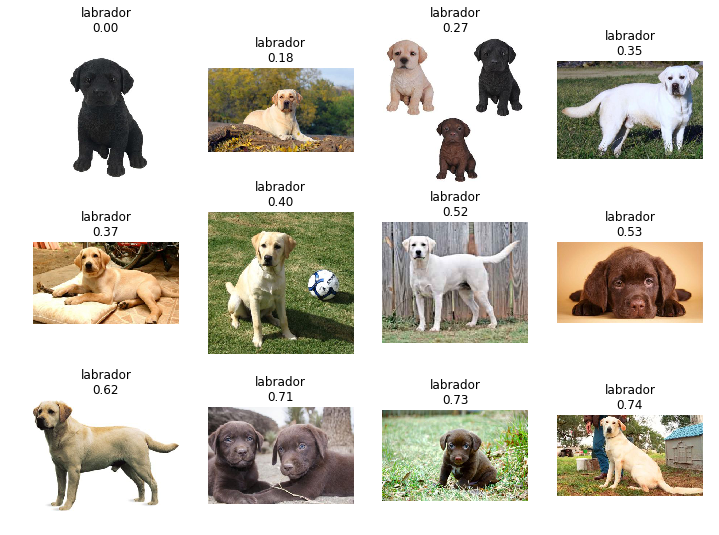

In [0]:
show_distances(
    data_container.train, new_image_index, indices[0].tolist(), distances[0].tolist()
)

In [0]:
learner.loss = tfa.losses.TripletSemiHardLoss()

In [0]:
learner.model = keras.Model(
    inputs=learner.base_model.input,
    outputs=keras.layers.Lambda(lambda x: tf.math.l2_normalize(x, axis=1))(
        keras.layers.Dense(10, activation=None)(learner.concat_layer)
    ),
)

In [0]:
learner.model.summary()

Model: "model_5"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [0]:
learner.compile(optimizer=tf.keras.optimizers.Adam, lr=1e-4)

In [0]:
history = learner.model.fit(
    x=data_container.train.data,
    validation_data=data_container.validation.data,
    steps_per_epoch=data_container.train.steps,
    validation_steps=data_container.validation.steps,
    epochs=3
)

Train for 138 steps, validate for 18 steps
Epoch 1/3
138/138 [==============================] - 378s 3s/step - loss: 0.1727 - val_loss: 0.1252
Epoch 2/3
138/138 [==============================] - 348s 3s/step - loss: 0.0673 - val_loss: 0.0936
Epoch 3/3
138/138 [==============================] - 344s 2s/step - loss: 0.0548 - val_loss: 0.1187


In [0]:
image_embeddings = learner.predict(
    pipeline=data_container.train.image_pipeline, image_paths=data_container.train.x
)

In [0]:
nbrs = sk.neighbors.NearestNeighbors(n_neighbors=11, algorithm="ball_tree").fit(
    image_embeddings
)

In [0]:
show_all_distances(learner,
                   data_container.train,
                  )

Output hidden; open in https://colab.research.google.com to view.

In [0]:
new_image_index = 1996

In [0]:
new_image_embeddings = learner.predict(
    pipeline=data_container.train.image_pipeline,
    image_paths=data_container.train.x[new_image_index : new_image_index + 1],
)

In [0]:
distances, indices = nbrs.kneighbors(new_image_embeddings)

In [0]:
[fn(new_image_embeddings) for fn in (np.min, np.max, np.median, np.mean, np.std)]

[-0.65246683, 0.37442046, 0.08209538, 0.009825018, 0.31607512]

In [0]:
distances[0].tolist(), indices[0].tolist()

([0.07345048004882784,
  0.0765114192688959,
  0.07896139374913574,
  0.08158565928497372,
  0.08172609855430245,
  0.08236430939531744,
  0.08499236758321427,
  0.09041595137063428,
  0.0922544836184774,
  0.0940831149861435,
  0.09478137057996713],
 [1511, 2756, 124, 1177, 1798, 342, 113, 659, 3985, 1996, 4301])

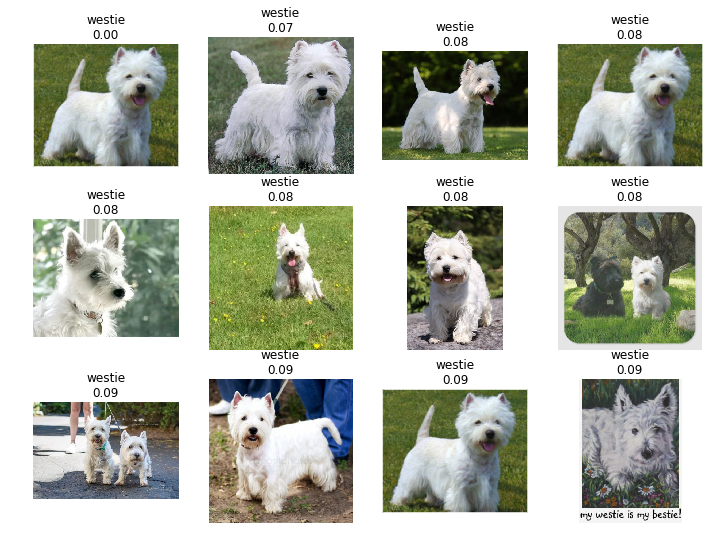

In [0]:
show_distances(
    data_container.train, new_image_index, indices[0].tolist(), distances[0].tolist()
)

# Conclusion

The best results achieved using triplet loss (Xception as base model) - Model 6 and Model 7.